# Modelling product affordability

<font color='red'><bold>  NOTE: these should be addressed also in the EDA part. </bold> 

Think about commercial implications 
- this is interesting from a manufacturer's perspective mostly - how would my product be priced if it were up to the market / competitors? 
- given the basic product information, what would customers expect of price? how is it priced vs competitors? 
- can i compete in certain areas which have higher prices [??? think about this more]
 
</font>

_________________________________________________________________________________

***Predicting product affordability***

The study sets out to determine whether we can model product affordability using the various product information available from the Sephora website (see list below). The target variable is the price affordability defined as: 
- 'Cheap': < \$15.13*
- 'Average': \$15.33 - 56.0*
- 'Expensive': > \$56.0*

*(based on price per volume to normalize for the varying product volumes which directly influence pricing)*

**An overview of the features used**
- num_likes
- rating
- num_reviews
- sensitive_type
- combination_type
- oily_type
- normal_type
- dry_type
- clean_sephora
- cruelty_free
- vegan
- best_for_skintype
- award
- clinical_results
- (skin concern targeted) AcneBlemishes, AntiAging, DarkCircles, Darkspots, Dryness, DullnessUnevenTexture, HairDryness, Hydrating, Lossoffirmness, Pores, Redness
- num_excl_ingr: number of excluded ingredients specifically mentioned in the product info
- (acids included) AHAGlycolicAcid, HyaluronicAcid, SalicylicAcid, VitaminC
- (formulation types) cream, gel, liquid, lotion, oil, others, serum
- (richnes of formula) heavy, light, normal
- (product_type) essences, serums & treatments, exfoliators & peels, eye cream and treatments, facial wash and cleansers
- brands

As an extension of the project, the ingredients for each product has also been included to determine how this affects product pricing.

Through the project, we hope to uncover more insights about: 

- How does the skincare product industry price its products? 
    - Based on these trends, which products are over- or under-priced? 
- What are the most important determinants in product pricing? 
  
  - How much weight does branding play in pricing strategies? Do some brands have more consistent pricing over others? Are there any brands that stand out when it comes to product pricing? 
    - How are awards and publishing of clinical results related to higher prices? 
    - Are products targeting specific skincare concerns generally priced more expensively than others? How about those catering to specific skintypes (i.e. sensitive skin)?
    - Is price affected by ratings, number of ratings or likes, or number of reviews? 
- Are there specific ingredients that potentially drive up price? 

__________________________________________________________________________________

<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Modelling-product-affordability" data-toc-modified-id="Modelling-product-affordability-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Modelling product affordability</a></span><ul class="toc-item"><li><span><a href="#Loading-file" data-toc-modified-id="Loading-file-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Loading file</a></span></li><li><span><a href="#Train-test-split" data-toc-modified-id="Train-test-split-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Train-test split</a></span></li><li><span><a href="#Feature-engineering" data-toc-modified-id="Feature-engineering-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Feature engineering</a></span></li><li><span><a href="#Modelling" data-toc-modified-id="Modelling-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Modelling</a></span><ul class="toc-item"><li><span><a href="#Baseline-performance" data-toc-modified-id="Baseline-performance-1.4.1"><span class="toc-item-num">1.4.1&nbsp;&nbsp;</span>Baseline performance</a></span></li><li><span><a href="#Logistic-Regression" data-toc-modified-id="Logistic-Regression-1.4.2"><span class="toc-item-num">1.4.2&nbsp;&nbsp;</span>Logistic Regression</a></span><ul class="toc-item"><li><span><a href="#Create-base-model-for-logistic-regression" data-toc-modified-id="Create-base-model-for-logistic-regression-1.4.2.1"><span class="toc-item-num">1.4.2.1&nbsp;&nbsp;</span>Create base model for logistic regression</a></span></li><li><span><a href="#Tuning-the-logistic-regression-model" data-toc-modified-id="Tuning-the-logistic-regression-model-1.4.2.2"><span class="toc-item-num">1.4.2.2&nbsp;&nbsp;</span>Tuning the logistic regression model</a></span></li><li><span><a href="#Insights-from-the-model" data-toc-modified-id="Insights-from-the-model-1.4.2.3"><span class="toc-item-num">1.4.2.3&nbsp;&nbsp;</span>Insights from the model</a></span></li><li><span><a href="#Retrain-the-model-with-less-features" data-toc-modified-id="Retrain-the-model-with-less-features-1.4.2.4"><span class="toc-item-num">1.4.2.4&nbsp;&nbsp;</span>Retrain the model with less features</a></span></li></ul></li><li><span><a href="#Support-Vector-Machines-(SVM)" data-toc-modified-id="Support-Vector-Machines-(SVM)-1.4.3"><span class="toc-item-num">1.4.3&nbsp;&nbsp;</span>Support Vector Machines (SVM)</a></span><ul class="toc-item"><li><span><a href="#Training-the-model" data-toc-modified-id="Training-the-model-1.4.3.1"><span class="toc-item-num">1.4.3.1&nbsp;&nbsp;</span>Training the model</a></span></li><li><span><a href="#Insights-from-the-model" data-toc-modified-id="Insights-from-the-model-1.4.3.2"><span class="toc-item-num">1.4.3.2&nbsp;&nbsp;</span>Insights from the model</a></span></li><li><span><a href="#Retraining-the-set-on-less-features" data-toc-modified-id="Retraining-the-set-on-less-features-1.4.3.3"><span class="toc-item-num">1.4.3.3&nbsp;&nbsp;</span>Retraining the set on less features</a></span></li><li><span><a href="#Evaluate-model-performance-based-on-reduced-feature-set" data-toc-modified-id="Evaluate-model-performance-based-on-reduced-feature-set-1.4.3.4"><span class="toc-item-num">1.4.3.4&nbsp;&nbsp;</span>Evaluate model performance based on reduced feature set</a></span></li></ul></li><li><span><a href="#Decision-Tree-Classifier" data-toc-modified-id="Decision-Tree-Classifier-1.4.4"><span class="toc-item-num">1.4.4&nbsp;&nbsp;</span>Decision Tree Classifier</a></span><ul class="toc-item"><li><span><a href="#Modelling-without-maximum-tree-depths" data-toc-modified-id="Modelling-without-maximum-tree-depths-1.4.4.1"><span class="toc-item-num">1.4.4.1&nbsp;&nbsp;</span>Modelling without maximum tree depths</a></span></li><li><span><a href="#Modelling-with-limitation-on-tree-depth" data-toc-modified-id="Modelling-with-limitation-on-tree-depth-1.4.4.2"><span class="toc-item-num">1.4.4.2&nbsp;&nbsp;</span>Modelling with limitation on tree depth</a></span></li><li><span><a href="#Insights-from-the-model" data-toc-modified-id="Insights-from-the-model-1.4.4.3"><span class="toc-item-num">1.4.4.3&nbsp;&nbsp;</span>Insights from the model</a></span></li><li><span><a href="#Retain-the-tree-model-using-selected-features" data-toc-modified-id="Retain-the-tree-model-using-selected-features-1.4.4.4"><span class="toc-item-num">1.4.4.4&nbsp;&nbsp;</span>Retain the tree model using selected features</a></span></li></ul></li><li><span><a href="#RandomForest-Model" data-toc-modified-id="RandomForest-Model-1.4.5"><span class="toc-item-num">1.4.5&nbsp;&nbsp;</span>RandomForest Model</a></span><ul class="toc-item"><li><span><a href="#Training-the-model-with-max-depth-imposed" data-toc-modified-id="Training-the-model-with-max-depth-imposed-1.4.5.1"><span class="toc-item-num">1.4.5.1&nbsp;&nbsp;</span>Training the model with max depth imposed</a></span></li><li><span><a href="#Insights-from-the-model" data-toc-modified-id="Insights-from-the-model-1.4.5.2"><span class="toc-item-num">1.4.5.2&nbsp;&nbsp;</span>Insights from the model</a></span></li><li><span><a href="#Reducing-the-number-of-features" data-toc-modified-id="Reducing-the-number-of-features-1.4.5.3"><span class="toc-item-num">1.4.5.3&nbsp;&nbsp;</span>Reducing the number of features</a></span></li><li><span><a href="#Optimize-the-RandomForest-model-using-GridSearch" data-toc-modified-id="Optimize-the-RandomForest-model-using-GridSearch-1.4.5.4"><span class="toc-item-num">1.4.5.4&nbsp;&nbsp;</span>Optimize the RandomForest model using GridSearch</a></span></li></ul></li><li><span><a href="#GradientBoosting" data-toc-modified-id="GradientBoosting-1.4.6"><span class="toc-item-num">1.4.6&nbsp;&nbsp;</span>GradientBoosting</a></span><ul class="toc-item"><li><span><a href="#Training-the-model" data-toc-modified-id="Training-the-model-1.4.6.1"><span class="toc-item-num">1.4.6.1&nbsp;&nbsp;</span>Training the model</a></span></li><li><span><a href="#Insights-from-the-model" data-toc-modified-id="Insights-from-the-model-1.4.6.2"><span class="toc-item-num">1.4.6.2&nbsp;&nbsp;</span>Insights from the model</a></span></li></ul></li><li><span><a href="#XGBoost" data-toc-modified-id="XGBoost-1.4.7"><span class="toc-item-num">1.4.7&nbsp;&nbsp;</span>XGBoost</a></span><ul class="toc-item"><li><span><a href="#Training-the-model" data-toc-modified-id="Training-the-model-1.4.7.1"><span class="toc-item-num">1.4.7.1&nbsp;&nbsp;</span>Training the model</a></span></li><li><span><a href="#Insights-from-the-model" data-toc-modified-id="Insights-from-the-model-1.4.7.2"><span class="toc-item-num">1.4.7.2&nbsp;&nbsp;</span>Insights from the model</a></span></li></ul></li></ul></li><li><span><a href="#Reviewing-the-results" data-toc-modified-id="Reviewing-the-results-1.5"><span class="toc-item-num">1.5&nbsp;&nbsp;</span>Reviewing the results</a></span><ul class="toc-item"><li><ul class="toc-item"><li><span><a href="#Review-the-various-model-performance" data-toc-modified-id="Review-the-various-model-performance-1.5.0.1"><span class="toc-item-num">1.5.0.1&nbsp;&nbsp;</span>Review the various model performance</a></span></li><li><span><a href="#Evaluate-results-on-test-set" data-toc-modified-id="Evaluate-results-on-test-set-1.5.0.2"><span class="toc-item-num">1.5.0.2&nbsp;&nbsp;</span>Evaluate results on test set</a></span></li></ul></li></ul></li><li><span><a href="#Saving-the-model-and-datasets" data-toc-modified-id="Saving-the-model-and-datasets-1.6"><span class="toc-item-num">1.6&nbsp;&nbsp;</span>Saving the model and datasets</a></span></li><li><span><a href="#Applying-the-model-to-predict-under-or-overpricing" data-toc-modified-id="Applying-the-model-to-predict-under-or-overpricing-1.7"><span class="toc-item-num">1.7&nbsp;&nbsp;</span>Applying the model to predict under or overpricing</a></span></li></ul></li><li><span><a href="#Extension:-Incorporating-product-ingredients" data-toc-modified-id="Extension:-Incorporating-product-ingredients-2"><span class="toc-item-num">2&nbsp;&nbsp;</span><em>Extension:</em> Incorporating product ingredients</a></span><ul class="toc-item"><li><span><a href="#Loading-the-complementary-dataset" data-toc-modified-id="Loading-the-complementary-dataset-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Loading the complementary dataset</a></span></li><li><span><a href="#Create-new-training-datasets" data-toc-modified-id="Create-new-training-datasets-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Create new training datasets</a></span></li><li><span><a href="#Modelling" data-toc-modified-id="Modelling-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Modelling</a></span><ul class="toc-item"><li><span><a href="#Utilising-existing-models-from-part-1" data-toc-modified-id="Utilising-existing-models-from-part-1-2.3.1"><span class="toc-item-num">2.3.1&nbsp;&nbsp;</span>Utilising existing models from part 1</a></span><ul class="toc-item"><li><span><a href="#SVM" data-toc-modified-id="SVM-2.3.1.1"><span class="toc-item-num">2.3.1.1&nbsp;&nbsp;</span>SVM</a></span></li><li><span><a href="#Logistic-regression" data-toc-modified-id="Logistic-regression-2.3.1.2"><span class="toc-item-num">2.3.1.2&nbsp;&nbsp;</span>Logistic regression</a></span></li><li><span><a href="#RandomForest" data-toc-modified-id="RandomForest-2.3.1.3"><span class="toc-item-num">2.3.1.3&nbsp;&nbsp;</span>RandomForest</a></span></li><li><span><a href="#XGBoost" data-toc-modified-id="XGBoost-2.3.1.4"><span class="toc-item-num">2.3.1.4&nbsp;&nbsp;</span>XGBoost</a></span></li><li><span><a href="#Gradient-boosting" data-toc-modified-id="Gradient-boosting-2.3.1.5"><span class="toc-item-num">2.3.1.5&nbsp;&nbsp;</span>Gradient boosting</a></span></li></ul></li><li><span><a href="#Retraining-selected-models" data-toc-modified-id="Retraining-selected-models-2.3.2"><span class="toc-item-num">2.3.2&nbsp;&nbsp;</span>Retraining selected models</a></span></li><li><span><a href="#Evaluating-model-performance" data-toc-modified-id="Evaluating-model-performance-2.3.3"><span class="toc-item-num">2.3.3&nbsp;&nbsp;</span>Evaluating model performance</a></span></li><li><span><a href="#Model-interpretability" data-toc-modified-id="Model-interpretability-2.3.4"><span class="toc-item-num">2.3.4&nbsp;&nbsp;</span>Model interpretability</a></span><ul class="toc-item"><li><span><a href="#Feature-importance" data-toc-modified-id="Feature-importance-2.3.4.1"><span class="toc-item-num">2.3.4.1&nbsp;&nbsp;</span>Feature importance</a></span></li><li><span><a href="#SHAP" data-toc-modified-id="SHAP-2.3.4.2"><span class="toc-item-num">2.3.4.2&nbsp;&nbsp;</span>SHAP</a></span></li></ul></li></ul></li><li><span><a href="#Train-on-entire-dataset" data-toc-modified-id="Train-on-entire-dataset-2.4"><span class="toc-item-num">2.4&nbsp;&nbsp;</span>Train on entire dataset</a></span></li><li><span><a href="#Saving-the-model-and-datasets" data-toc-modified-id="Saving-the-model-and-datasets-2.5"><span class="toc-item-num">2.5&nbsp;&nbsp;</span>Saving the model and datasets</a></span></li><li><span><a href="#See-output-of-final-model" data-toc-modified-id="See-output-of-final-model-2.6"><span class="toc-item-num">2.6&nbsp;&nbsp;</span>See output of final model</a></span></li></ul></li><li><span><a href="#Final-remarks" data-toc-modified-id="Final-remarks-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Final remarks</a></span></li></ul></div>

**Reference file:**
- pre_modelling_df.json: cleaned dataset before train-test split

**Summary of training sets created**

We created:
- X_tr
- X_tr_scaled
- X_tr_sc_select - scaled, top selected features from LR
- X_tr_select_final - scaled, optimally selected features from LR
- X_tr_selectsvm = unscaled, top 47 features based on SVM 
- X_tr_selectsvm = scaled, top 47 features based on SVM 

__________

## Loading file

In [1]:
import json 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os 
import datetime
import pydotplus
import re
import xgboost as xgb
import shap
import pickle

In [2]:
from sklearn.decomposition import PCA
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import KFold, RepeatedStratifiedKFold
from sklearn.model_selection import train_test_split, cross_validate, learning_curve
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import scale
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, roc_auc_score, accuracy_score, recall_score, precision_score, f1_score
from sklearn.metrics import classification_report, confusion_matrix, plot_confusion_matrix
from sklearn.metrics import precision_recall_curve, f1_score, auc, precision_score, log_loss, roc_curve
from sklearn.metrics import log_loss, matthews_corrcoef

In [3]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.dummy import DummyRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from bayes_opt import BayesianOptimization
from catboost import CatBoostClassifier, cv, Pool
from sklearn import svm
from sklearn.pipeline import make_pipeline

In [237]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit

In [4]:
from io import StringIO  
from IPython.display import Image  
from sklearn import tree, metrics
from matplotlib import pyplot
import warnings
warnings.filterwarnings('ignore')

In [5]:
with open('../data/processed_data/pre_modelling_data.json', 'r') as file:
    data= json.load(file)
df=pd.DataFrame.from_dict(data)

In [6]:
#fix column names
df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [7]:
#Editting and accessing this copy of the dataset
df1= df.copy()

## Train-test split

In [8]:
targeted_var = 'price_category'
excluded_features = ['product_name', 
                    #y values 
                     'pricepervol', 'affordability', 
                     #'affordability_bins',
                     'highlighted_ingr', 'ingr_list', 'price_category'
                    ]

In [9]:
X= df1.drop(columns=excluded_features)
y= df1[targeted_var]

In [10]:
y = y.astype('category')

In [11]:
X_tr, X_te, y_tr, y_te = train_test_split(X, y, test_size= 0.3, random_state=12,
                                        #stratify= y
                                         )

In [12]:
X_tr.shape, X_te.shape

((936, 175), (402, 175))

## Feature engineering

In [13]:
#Create a copy of datasets
X_tr_scaled = X_tr.copy()
X_te_scaled = X_te.copy()

In [14]:
#Scale selected columns
scaler= StandardScaler()
X_tr_scaled[['num_likes', 'num_reviews']] = scaler.fit_transform(X_tr_scaled[['num_likes', 'num_reviews']])
X_te_scaled[['num_likes', 'num_reviews']]=  scaler.transform(X_te_scaled[['num_likes', 'num_reviews']])

## Modelling

### Baseline performance

In [15]:
method='median'

In [16]:
ref = {'cheap': 1, 'average': 2, 'expensive': 3}
y_tr.temp = [ref[item] for item in y_tr.astype(str)]
y_te.temp = [ref[item] for item in y_te.astype(str)]

In [17]:
dumb_reg = DummyRegressor(strategy=method) 
dumb_reg.fit(X_tr_scaled, y_tr.temp)
y_tr_predtemp = dumb_reg.predict(X_tr_scaled)
#Model will predict the same value everytime
y_te_predtemp = float(dumb_reg.constant_) * np.ones(len(y_te.temp))

In [18]:
print(f'Assessing the model performance using a {method} baseline')
print('\nAccuracy Score')
print(f' Training set: {round(accuracy_score(y_tr.temp, y_tr_predtemp),4)}')
print(f' Testing set: {round(accuracy_score(y_te.temp, y_te_predtemp),4)}')
print('\nRecall Score')
print(' Training set:', round(recall_score(y_tr.temp, y_tr_predtemp, average='weighted'),4))
print(' Testing set:', round(recall_score(y_te.temp, y_te_predtemp, average='weighted'),4))
print('\nPrecision Score')
print('Training set:', round(precision_score(y_tr.temp, y_tr_predtemp, average='weighted'),4))
print('Testing set:', round(precision_score(y_te.temp, y_te_predtemp, average='weighted'),4))

Assessing the model performance using a median baseline

Accuracy Score
 Training set: 0.3269
 Testing set: 0.3507

Recall Score
 Training set: 0.3269
 Testing set: 0.3507

Precision Score
Training set: 0.1069
Testing set: 0.123


***Create custom-defined functions for model evaluation***

In [19]:
scores_list= ['accuracy', 'f1_weighted', 'precision_weighted', 'recall_weighted'
             #,'f1_micro', 'precision_micro' #removed as not imbalanced
             ]

In [20]:
#Initiating empty dictionary to store model performance
cv_records={
    'Description': [],
    'Accuracy (CV test) mean': [],
    'Accuracy (CV test) std': [],
    'Accuracy (CV train) mean': [],
    'Accuracy (CV train) std': [],
    'Recall (CV test) mean': [],
    'Recall (CV test) std': [],
    'Precision (weighted, CV) mean': [],
    'Precision (weighted, CV) std': [],
    'F1 (weighted, CV) mean': [],
    'F1 (weighted, CV) std': []}

In [21]:
#Creating a function to fetch CV scores for various models
def eval_model(fitted_model, X_train, y_train, num_cv=5, scores= scores_list, title='Model evaluation', show_train_scores=False, save=False):
    '''
    Uses cross-validation and returns a report of model performance metrics
    '''
    cv_results= cross_validate(fitted_model, X_train, y_train, cv=num_cv, scoring = scores, return_train_score=True)
    print(title)
    
    print('\nTest scores: (mean, SD)')
    for i in list(map(str, scores)):
        metric = 'test_'+i
        print(f' {str(i).title()}: \n ({round(cv_results[str(metric)].mean(),4)}, {round(cv_results[str(metric)].std(),4)})')
        
    if show_train_scores:
        print('\nTraining scores:')
        for i in list(map(str, scores)):
            metric = 'train_'+i
            print(f' {str(i).title()}: \n ({round(cv_results[str(metric)].mean(),4)}, {round(cv_results[str(metric)].std(),4)})')    
    else:
        pass 
    
    if save==True:
        cv_records['Description'].append(title)
        cv_records['Accuracy (CV test) mean'].append(cv_results['test_accuracy'].mean())
        cv_records['Accuracy (CV test) std'].append(cv_results['test_accuracy'].std())
        cv_records['Accuracy (CV train) mean'].append(cv_results['train_accuracy'].mean())
        cv_records['Accuracy (CV train) std'].append(cv_results['train_accuracy'].std())
        cv_records['Recall (CV test) mean'].append(cv_results['test_recall_weighted'].mean())
        cv_records['Recall (CV test) std'].append(cv_results['test_recall_weighted'].std())
        cv_records['Precision (weighted, CV) mean'].append(cv_results['test_precision_weighted'].mean())
        cv_records['Precision (weighted, CV) std'].append(cv_results['test_precision_weighted'].std())
        cv_records['F1 (weighted, CV) mean'].append(cv_results['test_f1_weighted'].mean())
        cv_records['F1 (weighted, CV) std'].append(cv_results['test_f1_weighted'].std())
    else:
        pass

In [22]:
#Creating a function to show ROC for various classes
def roc_auc_score_multiclass(actual_class, pred_class, average = "macro"):
    '''
    Returns a dictionary showing ROC-AUC score per class
    '''
    #creating a set of all the unique classes using the actual class list
    unique_class = set(actual_class)
    roc_auc_dict = {}
    scores=[]
    for per_class in unique_class:
        #creating a list of all the classes except the current class 
        other_class = [x for x in unique_class if x != per_class]

        #marking the current class as 1 and all other classes as 0
        new_actual_class = [0 if x in other_class else 1 for x in actual_class]
        new_pred_class = [0 if x in other_class else 1 for x in pred_class]

        #using the sklearn metrics method to calculate the roc_auc_score
        roc_auc = roc_auc_score(new_actual_class, new_pred_class, average = average)
        scores.append(roc_auc)
        roc_auc_dict[per_class] = round(roc_auc,4)

    print(f'Average ROC AUC score: {round(np.mean(scores),4)}')
    return roc_auc_dict

In [23]:
def plot_cm(fitted_model, X_test, y_test):
    '''
    Prints both normalized and non-normalized confusion matrix
    '''
    np.set_printoptions(precision=2)
    titles_options = [("Confusion matrix, without normalization:", None),
                              ("Normalized confusion matrix:", 'true')]
    for title, normalize in titles_options:
        disp = plot_confusion_matrix(fitted_model, X_test, y_test,
                                     #display_labels=['cheap','average','expensive'], #used € since $ won't work
                                             cmap=plt.cm.Blues,
                                             normalize=normalize)
        disp.ax_.set_title(title)

        print(title)
        print(disp.confusion_matrix)

    plt.show()

In [24]:
test_records={
    'Description': [],
    'Accuracy': [],
    'ROC-AUC-1': [],
    'ROC-AUC-2': [],
    'ROC-AUC-3': [],
    'F1_weighted': []}

In [25]:
def evaluate_test(fittedmodel, X_tr, X_te, y_tr, y_te, description='no description', save=False):
    '''
    Fit model and returns results on test set 
    '''
    #Fit the model 
    fittedmodel.fit(X_tr, y_tr)
    y_te_pred = fittedmodel.predict(X_te)
    print('Accuracy score on test:', accuracy_score(y_te, y_te_pred))
    lr_roc_auc_multiclass = roc_auc_score_multiclass(y_te, y_te_pred)
    print(lr_roc_auc_multiclass)
    print('Classification report: \n', classification_report(y_te, y_te_pred))
    plot_cm(fittedmodel, X_te, y_te)
    
    if save==True:
        test_records['Description'].append(description)
        test_records['Accuracy'].append(accuracy_score(y_te, y_te_pred))
        test_records['ROC-AUC-1'].append(lr_roc_auc_multiclass['cheap'])
        test_records['ROC-AUC-2'].append(lr_roc_auc_multiclass['average'])
        test_records['ROC-AUC-3'].append(lr_roc_auc_multiclass['expensive'])
        test_records['F1_weighted'].append(classification_report(y_te, y_te_pred, output_dict=True)['weighted avg']['f1-score'])

### Logistic Regression

#### Create base model for logistic regression

In [26]:
#Building base logistic regression model 
logreg= LogisticRegression(solver='saga', random_state=1, max_iter=1000) 

In [27]:
logreg.fit(X_tr_scaled, y_tr)
y_tr_pred = logreg.predict(X_tr_scaled)
y_te_pred = logreg.predict(X_te_scaled)

In [28]:
#Cross validated score
eval_model(logreg, X_tr_scaled, y_tr, 5, scores_list, 'LR - scaled training set, base (saga)', True, True)

LR - scaled training set, base (saga)

Test scores: (mean, SD)
 Accuracy: 
 (0.7383, 0.0358)
 F1_Weighted: 
 (0.7365, 0.037)
 Precision_Weighted: 
 (0.7405, 0.0369)
 Recall_Weighted: 
 (0.7383, 0.0358)

Training scores:
 Accuracy: 
 (0.8315, 0.0093)
 F1_Weighted: 
 (0.8317, 0.0093)
 Precision_Weighted: 
 (0.8323, 0.0094)
 Recall_Weighted: 
 (0.8315, 0.0093)


#### Tuning the logistic regression model

*Can we increase model performance by tuning the parameters?*

In [29]:
logreg_tuned=LogisticRegression(random_state=12)

solvers = ['newton-cg', 'lbfgs', 'sag', 'saga'] #chose the ones which can handle multinomial loss
penalty = ['l2', 'l1', 'elasticnet']
c_values = [100, 10, 1.0, 0.1, 0.01]
grid = dict(solver=solvers,penalty=penalty,C=c_values)


#will be using nested cross validation to pick the parameters 
outer_results=[]
cv_outer = KFold(n_splits=5, shuffle=True, random_state=1)
#for each fold of the outer split
for train_ix, test_ix in cv_outer.split(X_tr_scaled):
    X_traintemp, X_testtemp = X_tr_scaled.iloc[train_ix, :], X_tr_scaled.iloc[test_ix, :]
    y_traintemp, y_testtemp = y_tr.iloc[train_ix], y_tr.iloc[test_ix]
        
    #create the inner loop - dividing the 
    cv_inner = KFold(n_splits=3, shuffle=True, random_state=1)
        
    search = GridSearchCV(logreg_tuned, grid, scoring='accuracy', cv=cv_inner, refit=True)
            
    # find the best parameters
    result = search.fit(X_traintemp, y_traintemp)
        
    # use the best model found 
    best_model = result.best_estimator_
        
    # evaluate model
    yhat = best_model.predict(X_testtemp)
    acc = accuracy_score(y_testtemp, yhat)
    outer_results.append(acc)
    
    # report progress
    print('>acc=%.3f, best_score=%.3f, params=%s' % (acc, result.best_score_, result.best_params_))

    # summarize the estimated performance of the model
print('Average performance - accuracy: %.3f (+/- %.3f)' % (np.mean(outer_results), np.std(outer_results)))

>acc=0.734, best_score=0.725, params={'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
>acc=0.690, best_score=0.720, params={'C': 1.0, 'penalty': 'l2', 'solver': 'saga'}
>acc=0.733, best_score=0.718, params={'C': 1.0, 'penalty': 'l2', 'solver': 'sag'}
>acc=0.717, best_score=0.697, params={'C': 1.0, 'penalty': 'l2', 'solver': 'saga'}
>acc=0.727, best_score=0.694, params={'C': 100, 'penalty': 'l2', 'solver': 'sag'}
Average performance - accuracy: 0.720 (+/- 0.016)


The best performing parameter setting is here is the default setting, which was already used earlier. 

#### Insights from the model

*Which features are highly predictive of pricing?*

In [30]:
def plot_feature_importance(model, training_columns, method='abs_value', size=(12,25), n=-1):
    '''
    INPUT:
    model - fitted model such that there is a coefficient for the various features
    training_columns - X_train.columns 
    method - how to sort the graph ('abs_value' or 'coef')
    size - plot figure size
    n - top n number of features to show
    
    OUTPUT:
    Feature importance 
    '''
    fittedmodel = model
    title= model
    
    print('Model: ',title)
    
    if n<0:
        n= len(training_columns)
    print('Number of features displayed: {}/{}'.format(n, len(training_columns)))
    
    coef = np.transpose(fittedmodel.coef_.tolist()[0])
    lg_features= pd.DataFrame(zip(training_columns, coef, abs(coef)), columns=['features', 'coef', 'abs_value'])
    lg_features = lg_features.sort_values(method, ascending=False)
    
    zeroed = lg_features[lg_features.coef==0]
    print(f'Number of features with 0 coef: {len(zeroed)}')
    
    plt.figure(figsize=size)
    sns.barplot(y=lg_features.features[:n], x=lg_features.coef[:n], orient='h')
    plt.title('Feature Importance')
    #plt.savefig('topfeatures_lr.png', transparent= True, bbox_inches='tight')
    plt.show()

Model:  LogisticRegression(max_iter=1000, random_state=1, solver='saga')
Number of features displayed: 175/175
Number of features with 0 coef: 12


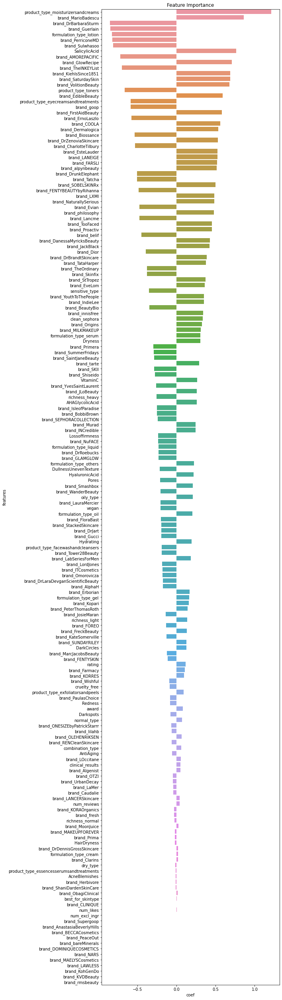

In [31]:
plot_feature_importance(logreg, X_tr_scaled.columns, 'abs_value', (8, 45))

***Observations***

*Features with highest predictive power:*
- Product type: coherent with initial findings during EDA 
- Numerous brands 
- Lotion formulation, Salicylic Acid, sensitive skin type, others


*Feature that have less predictive power*
- Certain brands have less sway on the predicting product affordability
- num_reviews has minimal predictive power
- num_likes and num_excl_ingr - minimal to no effect

12 features had 0 predictive power. Num_likes and num_excl_ingr 

#### Retrain the model with less features

*A. Based on logistic regression coefficients*

In [32]:
coef = np.transpose(logreg.coef_.tolist()[0])
feat= pd.DataFrame(zip(X_tr_scaled.columns, coef, abs(coef)), columns=['features', 'coef', 'abs_value'])
feat = feat.sort_values('abs_value', ascending=False)
select_lr_feat = feat[feat['abs_value']>0]
print(len(select_lr_feat), 'features with coefficients based on logistic regression')

163 features with coefficients based on logistic regression


Try training on less features to see change in performance

In [33]:
num_features= len(select_lr_feat)
#get feature names 
selected_feat_col = feat[:num_features]['features'].tolist()

#Create a new set of training set based on these selected features 
X_tr_select = X_tr[selected_feat_col]
X_te_select = X_te[selected_feat_col]
X_tr_sc_select = X_tr_scaled[selected_feat_col]
X_te_sc_select = X_te_scaled[selected_feat_col]

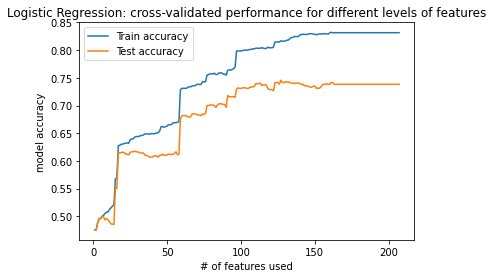

In [34]:
#Determine the optimal amount of features to use for the logistic regression model 
min_features= min(num_features - 45, 0)
max_features = max(num_features + 45, len(feat))
train_accuracy = []
test_accuracy= []
counter=[]
train_accuracy_sd= []
test_accuracy_sd= []
for i in range(min_features, max_features):
    feat_col = feat[:i]['features'].tolist()
    X_tr_sc_select = X_tr_scaled[feat_col]
    X_te_sc_select = X_te_scaled[feat_col]
    
    cv_results = cross_validate(logreg, X_tr_sc_select, y_tr, cv=5, scoring='accuracy', return_train_score= True)
    test_accuracy.append(cv_results['test_score'].mean())
    train_accuracy.append(cv_results['train_score'].mean())
    counter.append(i)
    train_accuracy_sd.append(cv_results['train_score'].std())
    test_accuracy_sd.append(cv_results['test_score'].std())
    
sns.lineplot(x=counter, y=train_accuracy, label='Train accuracy')
sns.lineplot(x=counter, y=test_accuracy, label = 'Test accuracy')
plt.title('Logistic Regression: cross-validated performance for different levels of features')
plt.ylabel('model accuracy')
plt.xlabel('# of features used')
plt.show()

Interestingly, there are spikes in model accuracy from increasing the number of features as shown above. There also comes a point wherein the model performance stabilizes despite increasing the feature space. We will determine the optimal number of features and check if this will improve the performance of the LR model as this may reduce the noise, making the model more robust.

In [35]:
temp = pd.DataFrame({'num_features':counter, 'train_score': train_accuracy, 'test_score': test_accuracy})
temp = temp.sort_values('test_score', ascending=False)
temp.iloc[:5]

,num_features,train_score,test_score
127,127,0.816775,0.745796
132,132,0.818110,0.742593
130,130,0.816508,0.742593
131,131,0.817843,0.742593
133,133,0.820514,0.741523


With these results, it is worth exploring whether we should reduce the feature set as it is higher than the model accuracy on the first logistic regression model, which predicted with 73.8% accuracy on the test set and 83% on the training set.

In [36]:
num_chosen_features= temp.iloc[0,0]
selected_feat_col = feat[:num_chosen_features]['features'].tolist()

print(f'Experiment with creating a new training set based on the {num_chosen_features} selected from logistic regression with penalty.')

Experiment with creating a new training set based on the 127 selected from logistic regression with penalty.


In [37]:
#Update the training set 
X_tr_select = X_tr[selected_feat_col]
X_te_select = X_te[selected_feat_col]
X_tr_sc_select = X_tr_scaled[selected_feat_col]
X_te_sc_select = X_te_scaled[selected_feat_col]

In [38]:
#Build a model based on optimised LR settings and selected features
logreg.fit(X_tr_sc_select, y_tr)
y_tr_pred = logreg.predict(X_tr_sc_select)
y_te_pred = logreg.predict(X_te_sc_select)

In [39]:
#Evaluate the CV performance using selected features and optimised parameters 
eval_model(logreg, X_tr_sc_select, y_tr, 5, scores_list, 'LR - scaled and selected (based on LR chosen features), base', True, True)

LR - scaled and selected (based on LR chosen features), base

Test scores: (mean, SD)
 Accuracy: 
 (0.7458, 0.0462)
 F1_Weighted: 
 (0.7447, 0.0471)
 Precision_Weighted: 
 (0.7486, 0.0469)
 Recall_Weighted: 
 (0.7458, 0.0462)

Training scores:
 Accuracy: 
 (0.8168, 0.003)
 F1_Weighted: 
 (0.8173, 0.0031)
 Precision_Weighted: 
 (0.8182, 0.0035)
 Recall_Weighted: 
 (0.8168, 0.003)


Indeed, the feature selection has been beneficial as it allowed us to achieve better results using less features.
On the training set, it has performed slightly worse (c.2%) which is expected; however, in the interest of model generalizability and cost of data collection, the drop in training set performance may be negligible. 

**B. Other feature selection methods**

Given the benefits of feature selection, it is worth exploring whether other feature selection methods like PCA can yield better results for us.

In [40]:
pca= PCA(0.95) #retain 95% of variance
pca.fit(X_tr_scaled)

PCA(n_components=0.95)

In [41]:
#How many features would explain 95% of the variance?
pca.n_components_

66

In [42]:
#Transform both training and test set 
X_tr_sc_pca = pca.transform(X_tr_scaled)
X_te_sc_pca = pca.transform(X_tr_scaled)

In [43]:
eval_model(logreg, X_tr_sc_pca, y_tr, 5, scores_list, 'LR - PCA scaled training set, base model', True, True)

LR - PCA scaled training set, base model

Test scores: (mean, SD)
 Accuracy: 
 (0.7212, 0.0368)
 F1_Weighted: 
 (0.72, 0.0372)
 Precision_Weighted: 
 (0.7238, 0.0369)
 Recall_Weighted: 
 (0.7212, 0.0368)

Training scores:
 Accuracy: 
 (0.7863, 0.0068)
 F1_Weighted: 
 (0.7868, 0.0069)
 Precision_Weighted: 
 (0.788, 0.0072)
 Recall_Weighted: 
 (0.7863, 0.0068)


Model performance is not better than previously trained LR model so the preferred feature selection method for now is from logistic regression (l2).

### Support Vector Machines (SVM)

Default kernel is rbf but let's check if a different kernel would yield better results.

#### Training the model

In [44]:
#Initiate SVM models with different kernels; used 'ovo' for multiclass strategy
linear = svm.SVC(kernel='linear', decision_function_shape='ovo', random_state=123)
rbf = svm.SVC(kernel='rbf', decision_function_shape='ovo', random_state=123)
poly = svm.SVC(kernel='poly', degree=3, decision_function_shape='ovo', random_state=123)
sig = svm.SVC(kernel='sigmoid', decision_function_shape='ovo', random_state=123)

In [45]:
#To evaluate with cross-validation
eval_model(linear, X_tr_scaled, y_tr, 5, scores_list, 'SVM - scaled training set, linear kernel', True, True)

SVM - scaled training set, linear kernel

Test scores: (mean, SD)
 Accuracy: 
 (0.7543, 0.0356)
 F1_Weighted: 
 (0.7546, 0.0361)
 Precision_Weighted: 
 (0.758, 0.039)
 Recall_Weighted: 
 (0.7543, 0.0356)

Training scores:
 Accuracy: 
 (0.8424, 0.0115)
 F1_Weighted: 
 (0.8428, 0.0114)
 Precision_Weighted: 
 (0.8436, 0.0113)
 Recall_Weighted: 
 (0.8424, 0.0115)


Superior results on both training and test set compared to the logistic regression model (both using the full feature set and the selected 127 features)

In [46]:
eval_model(poly, X_tr_scaled, y_tr, 5, scores_list, 'SVM - scaled training set, polynomial (3) kernel', True, True)

SVM - scaled training set, polynomial (3) kernel

Test scores: (mean, SD)
 Accuracy: 
 (0.6966, 0.0441)
 F1_Weighted: 
 (0.6954, 0.0453)
 Precision_Weighted: 
 (0.7095, 0.0481)
 Recall_Weighted: 
 (0.6966, 0.0441)

Training scores:
 Accuracy: 
 (0.7708, 0.0106)
 F1_Weighted: 
 (0.7718, 0.0101)
 Precision_Weighted: 
 (0.7791, 0.0096)
 Recall_Weighted: 
 (0.7708, 0.0106)


In [47]:
eval_model(rbf, X_tr_scaled, y_tr, 5, scores_list, 'SVM - scaled training set, radial basis kernel', True, True)

SVM - scaled training set, radial basis kernel

Test scores: (mean, SD)
 Accuracy: 
 (0.6859, 0.0386)
 F1_Weighted: 
 (0.6838, 0.0397)
 Precision_Weighted: 
 (0.6998, 0.0375)
 Recall_Weighted: 
 (0.6859, 0.0386)

Training scores:
 Accuracy: 
 (0.7268, 0.0109)
 F1_Weighted: 
 (0.7281, 0.0103)
 Precision_Weighted: 
 (0.7379, 0.0098)
 Recall_Weighted: 
 (0.7268, 0.0109)


In [48]:
eval_model(sig, X_tr_scaled, y_tr, 5, scores_list, 'SVM - scaled training set, sigmoid kernel', True, True)

SVM - scaled training set, sigmoid kernel

Test scores: (mean, SD)
 Accuracy: 
 (0.6827, 0.031)
 F1_Weighted: 
 (0.6791, 0.0321)
 Precision_Weighted: 
 (0.6882, 0.0357)
 Recall_Weighted: 
 (0.6827, 0.031)

Training scores:
 Accuracy: 
 (0.6918, 0.0106)
 F1_Weighted: 
 (0.691, 0.0099)
 Precision_Weighted: 
 (0.6997, 0.0081)
 Recall_Weighted: 
 (0.6918, 0.0106)


Better model is using the linear kernel so we will use this moving forwards.

#### Insights from the model

***What features did the SVM use to make these predictions?***

In [49]:
linear.fit(X_tr_scaled, y_tr)

SVC(decision_function_shape='ovo', kernel='linear', random_state=123)

Model:  SVC(decision_function_shape='ovo', kernel='linear', random_state=123)
Number of features displayed: 175/175
Number of features with 0 coef: 55


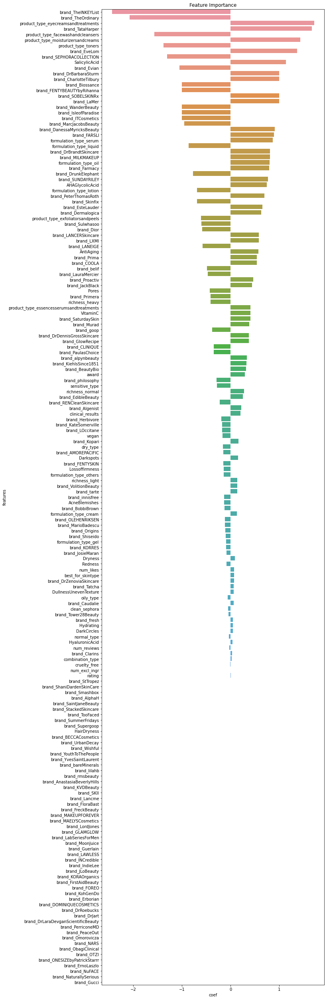

In [50]:
plot_feature_importance(linear, X_tr_scaled.columns, 'abs_value', (10,45))

***Observations:***
- Patterns in the highly and least predictive features have some overlap with what was found through logistic regression with top predictive features consisting mostly brands and product type. 
- In the SVM, 55 features had no predictive power and majority of these were also are brands. Another observation is that this is close to the number of optimal features based on logistic regression model. 
- Number of reviews and rating have low predictive power in this model.  

#### Retraining the set on less features

Again, we explore whether we can reduce the feature space further whilst maintaining good performance levels.

In [51]:
tempsvm= pd.DataFrame({'feature': X_tr_scaled.columns.tolist(), 
              'coef':linear.coef_[0], 
             'abs_values': abs(linear.coef_[0])}).sort_values('abs_values', ascending=False)

In [52]:
#Determine the optimal amount of features to use for the SVM model 
min_features= 50
max_features = 125
train_accuracy = []
test_accuracy= []
counter=[]
train_accuracy_sd= []
test_accuracy_sd= []
for i in range(min_features, max_features):
    X_tr_sc_selectsvm = X_tr_scaled[tempsvm[:i].feature.tolist()]
    X_te_sc_selectsvm = X_te_scaled[tempsvm[:i].feature.tolist()]

    cv_results = cross_validate(linear, X_tr_sc_selectsvm, y_tr, cv=5, scoring='accuracy', return_train_score= True)
    test_accuracy.append(cv_results['test_score'].mean())
    train_accuracy.append(cv_results['train_score'].mean())
    counter.append(i)
    train_accuracy_sd.append(cv_results['train_score'].std())
    test_accuracy_sd.append(cv_results['test_score'].std())

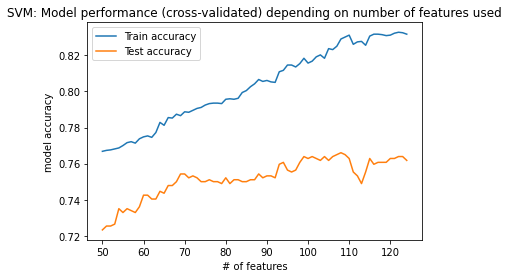

In [53]:
sns.lineplot(x=counter, y=train_accuracy, label='Train accuracy')
sns.lineplot(x=counter, y=test_accuracy, label = 'Test accuracy')
plt.title('SVM: Model performance (cross-validated) depending on number of features used')
plt.xlabel('# of features')
plt.ylabel('model accuracy')
plt.show()

In [54]:
#At which point do we get peak level performance?
tempsvm1 = pd.DataFrame({'num_features':counter, 'train_score': train_accuracy, 'test_score': test_accuracy})
tempsvm1= tempsvm1.sort_values(by='test_score', ascending=False)
tempsvm1[:5]

,num_features,train_score,test_score
58,108,0.829062,0.766066
59,109,0.830130,0.764996
57,107,0.825057,0.764996
73,123,0.832534,0.763944
72,122,0.832801,0.763944


In [55]:
num_svm_features =tempsvm1.iloc[0,0]
print(f'Create a new training set based on feature importance found through SVM - {num_svm_features} features')

Create a new training set based on feature importance found through SVM - 108 features


In [56]:
#unscaled
X_tr_selectsvm = X_tr[tempsvm[:num_svm_features].feature.tolist()]
X_te_selectsvm = X_te[tempsvm[:num_svm_features].feature.tolist()]

#scaled
X_tr_sc_selectsvm = X_tr_scaled[tempsvm[:num_svm_features].feature.tolist()]
X_te_sc_selectsvm = X_te_scaled[tempsvm[:num_svm_features].feature.tolist()]

#### Evaluate model performance based on reduced feature set

In [57]:
#SVM based on feature selection through SVM 
eval_model(linear, X_tr_sc_selectsvm, y_tr, 5, scores_list, 'SVM (linear) - scaled training set, selected features using SVM', True, True)

SVM (linear) - scaled training set, selected features using SVM

Test scores: (mean, SD)
 Accuracy: 
 (0.7661, 0.0344)
 F1_Weighted: 
 (0.766, 0.0339)
 Precision_Weighted: 
 (0.7706, 0.0335)
 Recall_Weighted: 
 (0.7661, 0.0344)

Training scores:
 Accuracy: 
 (0.8291, 0.0071)
 F1_Weighted: 
 (0.8294, 0.007)
 Precision_Weighted: 
 (0.8301, 0.0071)
 Recall_Weighted: 
 (0.8291, 0.0071)


We see a similar scenario to the previous exercise where there is an uplift in test performance with some decrease in training score.

Compared to the LR model, we are now using an even smaller feature set (108/175) and achieving a higher acurracy score.

In [58]:
#SVM based on PCA features
eval_model(linear, X_tr_sc_pca, y_tr, 5, scores_list, 'SVM - PCA features, linear', True, True)

SVM - PCA features, linear

Test scores: (mean, SD)
 Accuracy: 
 (0.7351, 0.0276)
 F1_Weighted: 
 (0.7347, 0.0278)
 Precision_Weighted: 
 (0.7394, 0.0294)
 Recall_Weighted: 
 (0.7351, 0.0276)

Training scores:
 Accuracy: 
 (0.7903, 0.013)
 F1_Weighted: 
 (0.7909, 0.0129)
 Precision_Weighted: 
 (0.7923, 0.0128)
 Recall_Weighted: 
 (0.7903, 0.013)


Testing the PCA training set on the logistic regression and SVM model shows that the other revised training sets (reduced from either SVM or LR) are superior.

In [59]:
#SVM based on LR feature selection
eval_model(linear, X_tr_sc_select, y_tr, 5, scores_list,'SVM - scaled training set, selected features using LR', True, True)

SVM - scaled training set, selected features using LR

Test scores: (mean, SD)
 Accuracy: 
 (0.7522, 0.0408)
 F1_Weighted: 
 (0.7525, 0.0413)
 Precision_Weighted: 
 (0.7572, 0.0415)
 Recall_Weighted: 
 (0.7522, 0.0408)

Training scores:
 Accuracy: 
 (0.8259, 0.0087)
 F1_Weighted: 
 (0.8265, 0.0087)
 Precision_Weighted: 
 (0.8278, 0.0086)
 Recall_Weighted: 
 (0.8259, 0.0087)


This is interesting as we see that the culled feature set using logistic regression performs well also on the SVM model. In fact, this performs better than the optimal model performance from logistic regression (LR on selected features using LR). 

How well will the SVM feature set perform using other models?

In [60]:
eval_model(logreg, X_tr_sc_selectsvm, y_tr, 5, scores_list,'LR - scaled SVM feature set', True, True)

LR - scaled SVM feature set

Test scores: (mean, SD)
 Accuracy: 
 (0.7501, 0.0404)
 F1_Weighted: 
 (0.7498, 0.04)
 Precision_Weighted: 
 (0.7542, 0.0379)
 Recall_Weighted: 
 (0.7501, 0.0404)

Training scores:
 Accuracy: 
 (0.8176, 0.007)
 F1_Weighted: 
 (0.8179, 0.007)
 Precision_Weighted: 
 (0.8188, 0.0072)
 Recall_Weighted: 
 (0.8176, 0.007)


Not bad! We see comparable and relatively stable model performance. This gives us more confidence that the selected feature set is predictive of pricing.

### Decision Tree Classifier

In [61]:
tree_criterion = 'entropy' #gini or entropy
tree_depth = None

In [62]:
dtree = DecisionTreeClassifier(criterion=tree_criterion, max_depth = tree_depth, random_state=123)
dtree.fit(X_tr_scaled, y_tr)

DecisionTreeClassifier(criterion='entropy', random_state=123)

In [63]:
y_tr_pred = dtree.predict(X_tr_scaled)
y_te_pred = dtree.predict(X_te_scaled)

In [64]:
def decision_tree(X_train, X_test, y_train, y_test, tree_criterion, tree_depth=None, disp_cm=0):
    '''
    Runs a decision tree criterion based on inputs
    Returns evaluation metrics
    '''
    dtree = DecisionTreeClassifier(criterion=tree_criterion, max_depth = tree_depth, random_state=123)
    dtree.fit(X_train, y_train)
    
    y_train_pred = dtree.predict(X_train)
    y_test_pred = dtree.predict(X_test)
    
    print(f'Decision Tree model - {tree_criterion} criterion, max depth: {tree_depth}')
    print(f'Accuracy (train): \t %.4f' %metrics.accuracy_score(y_train ,y_train_pred))
    print(f'Accuracy (test): \t %.4f' %metrics.accuracy_score(y_test ,y_test_pred))
    print(f'Balanced accuracy:\t %.4f' %metrics.balanced_accuracy_score(y_test,y_test_pred))
    print('Classification report: \n', classification_report(y_test, y_test_pred))
    
    if disp_cm>0:
        np.set_printoptions(precision=2)
        titles_options = [("Confusion matrix, without normalization:", None),
                          ("Normalized confusion matrix:", 'true')]
        for title, normalize in titles_options:
            disp = plot_confusion_matrix(dtree, X_test, y_test,
                                             cmap=plt.cm.Blues,
                                             normalize=normalize)
            disp.ax_.set_title(title)

            print(title)
            print(disp.confusion_matrix)

        plt.show()

#### Modelling without maximum tree depths

In [65]:
decision_tree(X_tr_scaled, X_te_scaled, y_tr, y_te, 'entropy', None)

Decision Tree model - entropy criterion, max depth: None
Accuracy (train): 	 1.0000
Accuracy (test): 	 0.6219
Balanced accuracy:	 0.6236
Classification report: 
               precision    recall  f1-score   support

     average       0.52      0.54      0.53       141
       cheap       0.76      0.68      0.72       136
   expensive       0.61      0.65      0.63       125

    accuracy                           0.62       402
   macro avg       0.63      0.62      0.63       402
weighted avg       0.63      0.62      0.62       402



In [66]:
decision_tree(X_tr_scaled, X_te_scaled, y_tr, y_te, 'gini', None)

Decision Tree model - gini criterion, max depth: None
Accuracy (train): 	 1.0000
Accuracy (test): 	 0.6766
Balanced accuracy:	 0.6791
Classification report: 
               precision    recall  f1-score   support

     average       0.58      0.57      0.58       141
       cheap       0.78      0.75      0.76       136
   expensive       0.67      0.72      0.69       125

    accuracy                           0.68       402
   macro avg       0.68      0.68      0.68       402
weighted avg       0.68      0.68      0.68       402



***Observations:***
- In both models: 
    - Without a limit on the tree depth, the model overfits entirely, as expected.
    - Better prediction for the cheap and expensive segments

#### Modelling with limitation on tree depth

In order to avoid overfitting and improve generalisability of the model, we will impose a max depth on the trees built. As tree model performance varies depending on the depth used, this will be explored further.

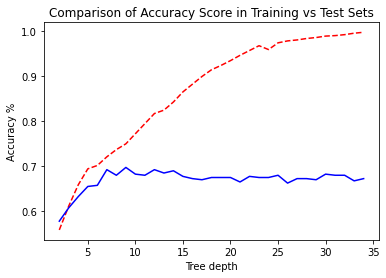

In [67]:
depths = [n for n in range(2, 35)]
training_score= []
testing_score=[]

for val in depths: 
    dtree = DecisionTreeClassifier(criterion='gini', max_depth = val, random_state=123)
    dtree.fit(X_tr_scaled, y_tr)
    
    y_train_pred = dtree.predict(X_tr_scaled)
    y_test_pred = dtree.predict(X_te_scaled)
    
    training_score.append(metrics.accuracy_score(y_tr ,y_train_pred))
    testing_score.append(metrics.accuracy_score(y_te ,y_test_pred))

plt.plot(depths, training_score, linestyle='dashed', color='red')
plt.plot(depths, testing_score, linestyle='solid', color='blue')
plt.title('Comparison of Accuracy Score in Training vs Test Sets')
plt.xlabel('Tree depth')
plt.ylabel('Accuracy %')
plt.show()

In [68]:
decision_tree(X_tr_scaled, X_te_scaled, y_tr, y_te, 'gini', 8)

Decision Tree model - gini criterion, max depth: 8
Accuracy (train): 	 0.7361
Accuracy (test): 	 0.6791
Balanced accuracy:	 0.6758
Classification report: 
               precision    recall  f1-score   support

     average       0.53      0.81      0.64       141
       cheap       0.91      0.60      0.73       136
   expensive       0.79      0.62      0.69       125

    accuracy                           0.68       402
   macro avg       0.74      0.68      0.69       402
weighted avg       0.74      0.68      0.69       402



In [69]:
decision_tree(X_tr_scaled, X_te_scaled, y_tr, y_te, 'entropy', 8)

Decision Tree model - entropy criterion, max depth: 8
Accuracy (train): 	 0.7350
Accuracy (test): 	 0.6866
Balanced accuracy:	 0.6831
Classification report: 
               precision    recall  f1-score   support

     average       0.54      0.82      0.65       141
       cheap       0.92      0.62      0.74       136
   expensive       0.79      0.62      0.69       125

    accuracy                           0.69       402
   macro avg       0.75      0.68      0.69       402
weighted avg       0.75      0.69      0.69       402



*Observations*
- Based on the visualisation above, the better model uses a gini criterion with a max depth of 8 layers. 
- Performance-wise, however, the lift is not significant. 

In [70]:
dtree2 = DecisionTreeClassifier(criterion='entropy', max_depth = 8, random_state=123)
dtree2.fit(X_tr_scaled, y_tr)

DecisionTreeClassifier(criterion='entropy', max_depth=8, random_state=123)

In [71]:
y_tr_pred = dtree2.predict(X_tr_scaled)
y_te_pred = dtree2.predict(X_te_scaled)

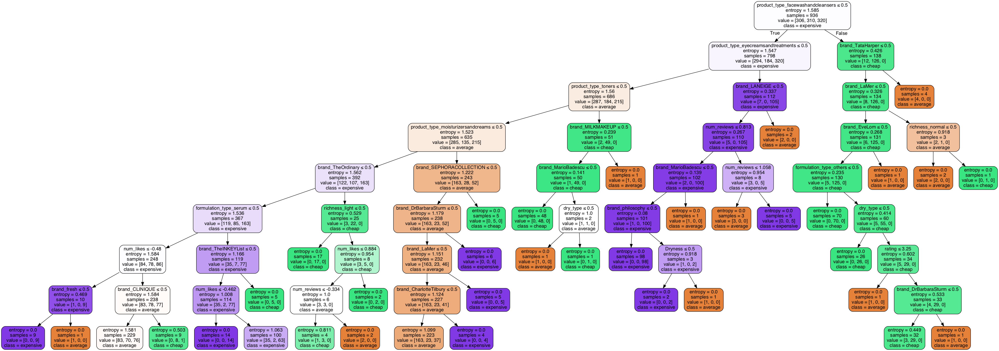

In [72]:
dot_data = StringIO()

#Create DOT data 
tree.export_graphviz(dtree2, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, 
                class_names = ['average', 'cheap', 'expensive'],
                feature_names=X_tr_scaled.columns
                ) 

#Draw graph
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
#Show graph
Image(graph.create_png())

#Save to file 
#graph.write_png('decisiontree.png')

#### Insights from the model

- The model first determines what type of product it is (i.e. toner, cleanser, serum, etc.) then it determines the brand and at times, also uses other features such as number of likes, number of reviews, formulation type, and rating to determine the price category. 
- Main features used: product type, brands
- Interesting insights:
    - Eyecreams are usually expensive. However, we do find averagely priced products too (typically from Laneige and Mario Badescu).
    - Moisturizers and creams fall under the average price category except if it is from Dr. Barbara Sturm, La Mer and Charlotte Tilbury, in which case, they would be expensive! You can find cheap ones at Sephora though.
    - Face wash / Cleansers and toners are affordable with prices in the cheap-average range. Toners at Milk Makeup or Mario Badescu tend to be more expensive than its competitors. For facewash, we can expect higher price points from brands like La Tata Harper, La Mer, Eve Lom and Dr. Barbara Sturm.
    - Generally, you can expect low prices from The Ordinary serums. 
    - Serums are typically expensive except if you get them from The InkeyList which you can expect to be cheap.
    - Face wash and cleansers are usually cheap or priced averagely. 

In [73]:
#Check accuracy 
eval_model(dtree2, X_tr_scaled, y_tr, 5, scores_list, 'DT - full scaled training set with with max depth imposed', True, True)

DT - full scaled training set with with max depth imposed

Test scores: (mean, SD)
 Accuracy: 
 (0.6731, 0.0326)
 F1_Weighted: 
 (0.6745, 0.0361)
 Precision_Weighted: 
 (0.7204, 0.0517)
 Recall_Weighted: 
 (0.6731, 0.0326)

Training scores:
 Accuracy: 
 (0.7503, 0.0158)
 F1_Weighted: 
 (0.7547, 0.0154)
 Precision_Weighted: 
 (0.7914, 0.0166)
 Recall_Weighted: 
 (0.7503, 0.0158)


<font color='red'> Is there a way that we can change the nodes here to be brand = 'X' or brand>= 0.5 instead of the other way around as it is confusing for the reader. </font>

#### Retain the tree model using selected features

*Can we increase model performance using the feature selection from other models?*

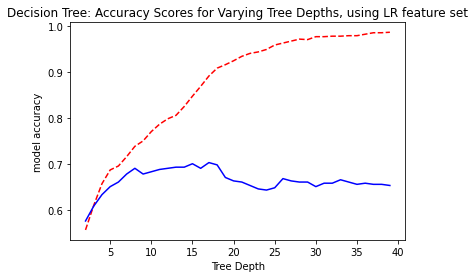

In [74]:
#Using features from logistic regression 

#Also determine the optimal depth for the tree
depths = [n for n in range(2, 40)]
training_score= []
testing_score=[]

for val in depths: 
    dtree = DecisionTreeClassifier(criterion='entropy', max_depth = val, random_state=123)
    dtree.fit(X_tr_select, y_tr)
    
    #we use non-scaled set here
    y_train_pred = dtree.predict(X_tr_select)
    y_test_pred = dtree.predict(X_te_select)
    
    training_score.append(metrics.accuracy_score(y_tr ,y_train_pred))
    testing_score.append(metrics.accuracy_score(y_te ,y_test_pred))

plt.plot(depths, training_score, linestyle='dashed', color='red')
plt.plot(depths, testing_score, linestyle='solid', color='blue')
plt.title('Decision Tree: Accuracy Scores for Varying Tree Depths, using LR feature set')
plt.xlabel('Tree Depth')
plt.ylabel('model accuracy')
plt.show()

In [75]:
tempdt = pd.DataFrame({'depth': depths, 'training_score': training_score, 'testing_score': testing_score})
tempdt= tempdt.sort_values(by='testing_score', ascending=False)
max_depth = tempdt.iloc[0,0]
tempdt

,depth,training_score,testing_score
15,17,0.892094,0.703980
13,15,0.848291,0.701493
16,18,0.909188,0.699005
12,14,0.825855,0.694030
11,13,0.806624,0.694030
14,16,0.869658,0.691542
10,12,0.799145,0.691542
6,8,0.739316,0.691542
9,11,0.787393,0.689055
8,10,0.771368,0.684080


In [76]:
dtree_lgfeatures = DecisionTreeClassifier(criterion='entropy', max_depth = max_depth, random_state=123)

In [77]:
dtree_lgfeatures.fit(X_tr_select, y_tr)
y_tr_pred = dtree_lgfeatures.predict(X_tr_select)
y_te_pred = dtree_lgfeatures.predict(X_te_select)

In [78]:
#Check accuracy 
eval_model(dtree_lgfeatures, X_tr_select, y_tr, 5, scores_list, 'DT - scaled and chosen from LR set, with max depth', True, True)

DT - scaled and chosen from LR set, with max depth

Test scores: (mean, SD)
 Accuracy: 
 (0.6752, 0.0277)
 F1_Weighted: 
 (0.6771, 0.0287)
 Precision_Weighted: 
 (0.689, 0.0303)
 Recall_Weighted: 
 (0.6752, 0.0277)

Training scores:
 Accuracy: 
 (0.8897, 0.0109)
 F1_Weighted: 
 (0.8908, 0.0105)
 Precision_Weighted: 
 (0.8975, 0.0095)
 Recall_Weighted: 
 (0.8897, 0.0109)


Model performs well on the training set but it is concerning that the test scores are not as high. It is possible that by increasing the tree depth, the model has started overfitting as training scores increase without material uplift in testing performance.

The previous classifiers have achieved superior results although the decision tree has good interpretability. 

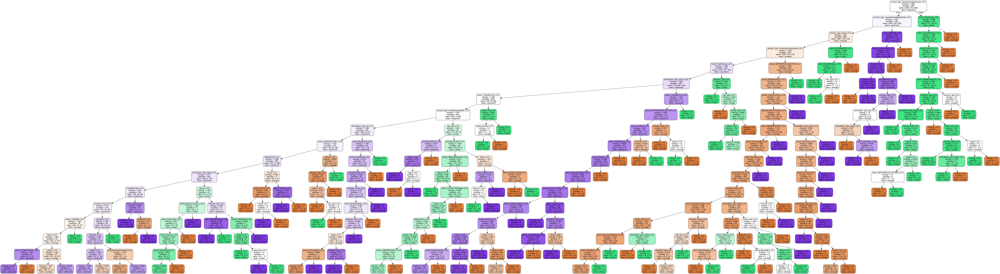

In [79]:
dot_data2 = StringIO()

tree.export_graphviz(dtree_lgfeatures, out_file=dot_data2,  
                filled=True, rounded=True,
                special_characters=True, 
                feature_names=X_tr_select.columns,
                class_names = ['average', 'cheap', 'expensive']
                ) 

graph = pydotplus.graph_from_dot_data(dot_data2.getvalue())  
#graph.write_pdf('tree.pdf')
Image(graph.create_png())

### RandomForest Model

In [80]:
#First try the default settings for RF
rf = RandomForestClassifier(random_state = 123, n_jobs=-1)

In [81]:
eval_model(rf, X_tr, y_tr, 5, scores_list, 'RandomForest - no max depth', True)

RandomForest - no max depth

Test scores: (mean, SD)
 Accuracy: 
 (0.7265, 0.0338)
 F1_Weighted: 
 (0.7265, 0.0334)
 Precision_Weighted: 
 (0.7299, 0.0338)
 Recall_Weighted: 
 (0.7265, 0.0338)

Training scores:
 Accuracy: 
 (1.0, 0.0)
 F1_Weighted: 
 (1.0, 0.0)
 Precision_Weighted: 
 (1.0, 0.0)
 Recall_Weighted: 
 (1.0, 0.0)


Using the default parameters, it will overfit as we did not set a max depth.

#### Training the model with max depth imposed

In [82]:
rf_criterion='entropy' #default: gini
estimators= 100
rf_depth=6
rf2= RandomForestClassifier(n_estimators = estimators, criterion = rf_criterion,   
                            max_depth= rf_depth, random_state = 123, n_jobs=-1)

In [83]:
rf2.fit(X_tr, y_tr)
y_tr_pred= rf2.predict(X_tr)
y_te_pred= rf2.predict(X_te)

In [84]:
#Since RF is not distance based, we can try non-scaled 
eval_model(rf2, X_tr, y_tr, 5, scores_list, 'RandomForest model - max depth imposed', True, True)

RandomForest model - max depth imposed

Test scores: (mean, SD)
 Accuracy: 
 (0.7041, 0.0397)
 F1_Weighted: 
 (0.7, 0.0424)
 Precision_Weighted: 
 (0.7025, 0.0436)
 Recall_Weighted: 
 (0.7041, 0.0397)

Training scores:
 Accuracy: 
 (0.7871, 0.0066)
 F1_Weighted: 
 (0.7859, 0.0072)
 Precision_Weighted: 
 (0.786, 0.0069)
 Recall_Weighted: 
 (0.7871, 0.0066)


#### Insights from the model

*Which feature are predictive of pricing?*

In [85]:
#Visualizing one of the trees in rf
estimator = rf2.estimators_[5]
from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X_tr_scaled.columns,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

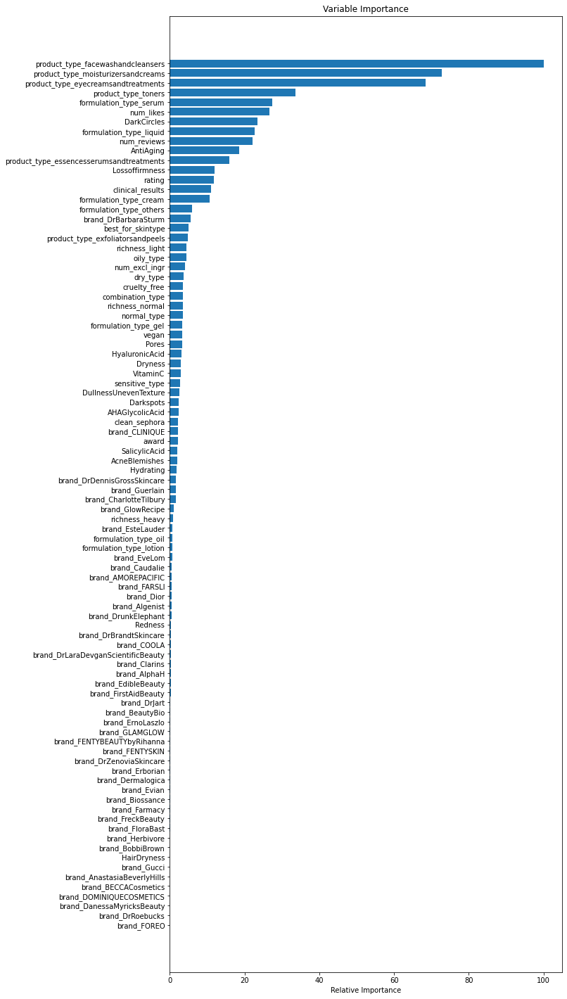

In [86]:
feature_importances = rf2.feature_importances_
# make importances relative to max importance
feature_importances = 100.0 * (feature_importances / feature_importances.max())[:90]
sorted_idx = np.argsort(feature_importances)[:90]

pos = np.arange(sorted_idx.shape[0]) + .5
sorted_idx.size
plt.figure(figsize=(10,25))
plt.barh(pos, feature_importances[sorted_idx], align='center')
plt.yticks(pos, X.columns[sorted_idx])
plt.xlabel('Relative Importance')
plt.title('Variable Importance')
plt.show()

Interesting how the RF model has not used brands as much in its prediction model! 
Using the concept of entropy, it makes sense to split the dataset based on general features first. 

With further research, most brands have a range of products. Based on what we learned from the earlier models, different product types have varying price points so splitting on brands will not create homogeneous groups.

> If i wanted to build a model without using the brands, it would probably look like this right? 

<font color='red'> TBD: Whilst there is some overlap in the top features, there are also noticeable differences -i.e. number of likes, reviews are more important in this model. Generally, it looks like the brands were not as high of predictors as the basic product information. interesting finding! 

- makes sense for Rf to make predictions like this actually </font>

#### Reducing the number of features

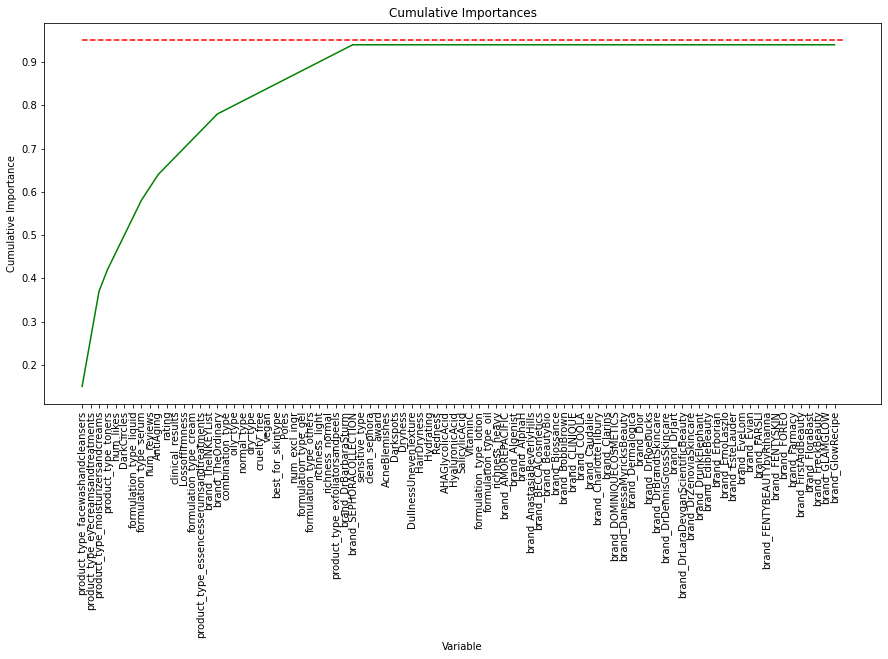

In [87]:
#How many features are important? 
feat_list =[(feature, round(feature_importance, 2))
    for feature, feature_importance in zip(X_tr.columns, rf2.feature_importances_.tolist())]
feat_list = sorted(feat_list, key = lambda x:x[1], reverse=True)[:90]
x_values = list(range(90))
# List of features sorted from most to least important
sorted_importances = [importance[1] for importance in feat_list]
sorted_features = [importance[0] for importance in feat_list]
# Cumulative importances
cumulative_importances = np.cumsum(sorted_importances)
# Make a line graph
plt.figure(figsize=(15,7))
plt.plot(x_values, cumulative_importances, 'g-')
# Draw line at 95% of importance retained
plt.hlines(y = 0.95, xmin=0, xmax=len(sorted_importances), color = 'r', linestyles = 'dashed')
# Format x ticks and labels
plt.xticks(x_values, sorted_features, rotation = 'vertical')
# Axis labels and title
plt.xlabel('Variable'); plt.ylabel('Cumulative Importance'); 
plt.title('Cumulative Importances');
plt.show()

In [88]:
# Extract the names of the most important features
important_feature_names = [feature[0] for feature in feat_list[0:35]]
important_feature_names

['product_type_facewashandcleansers',
 'product_type_eyecreamsandtreatments',
 'product_type_moisturizersandcreams',
 'product_type_toners',
 'num_likes',
 'DarkCircles',
 'formulation_type_liquid',
 'formulation_type_serum',
 'num_reviews',
 'AntiAging',
 'rating',
 'clinical_results',
 'Lossoffirmness',
 'formulation_type_cream',
 'product_type_essencesserumsandtreatments',
 'brand_TheINKEYList',
 'brand_TheOrdinary',
 'combination_type',
 'oily_type',
 'normal_type',
 'dry_type',
 'cruelty_free',
 'vegan',
 'best_for_skintype',
 'Pores',
 'num_excl_ingr',
 'formulation_type_gel',
 'formulation_type_others',
 'richness_light',
 'richness_normal',
 'product_type_exfoliatorsandpeels',
 'brand_DrBarbaraSturm',
 'brand_SEPHORACOLLECTION',
 'sensitive_type',
 'clean_sephora']

In [89]:
print(f'Creating new training sets based on {len(important_feature_names)} features selected using RF')

Creating new training sets based on 35 features selected using RF


In [90]:
X_tr_selectrf = X_tr.loc[:, important_feature_names].copy()
X_te_selectrf = X_te.loc[:, important_feature_names].copy()

X_tr_sc_selectrf = X_tr_scaled.loc[:, important_feature_names].copy()
X_te_sc_selectrf = X_te_scaled.loc[:, important_feature_names].copy()

In [91]:
eval_model(rf2, X_tr_sc_selectrf, y_tr, 5, scores_list, 'RF culled training set', True)

RF culled training set

Test scores: (mean, SD)
 Accuracy: 
 (0.703, 0.0329)
 F1_Weighted: 
 (0.6995, 0.0366)
 Precision_Weighted: 
 (0.7034, 0.0393)
 Recall_Weighted: 
 (0.703, 0.0329)

Training scores:
 Accuracy: 
 (0.7695, 0.0088)
 F1_Weighted: 
 (0.7678, 0.0097)
 Precision_Weighted: 
 (0.7686, 0.0087)
 Recall_Weighted: 
 (0.7695, 0.0088)


Using a much smaller dataset, it has achieved a similar performance!

**How would the previous models perform on the training set selected by RandomForest?**

In [92]:
eval_model(logreg, X_tr_sc_selectrf, y_tr, 5, scores_list, 'RF culled training set', True)

RF culled training set

Test scores: (mean, SD)
 Accuracy: 
 (0.7233, 0.0289)
 F1_Weighted: 
 (0.7229, 0.0289)
 Precision_Weighted: 
 (0.7281, 0.0294)
 Recall_Weighted: 
 (0.7233, 0.0289)

Training scores:
 Accuracy: 
 (0.7548, 0.0074)
 F1_Weighted: 
 (0.7555, 0.0077)
 Precision_Weighted: 
 (0.7574, 0.0083)
 Recall_Weighted: 
 (0.7548, 0.0074)


In [93]:
eval_model(linear, X_tr_sc_selectrf, y_tr, 5, scores_list, 'RF culled training set', True)

RF culled training set

Test scores: (mean, SD)
 Accuracy: 
 (0.718, 0.0358)
 F1_Weighted: 
 (0.7166, 0.0381)
 Precision_Weighted: 
 (0.7231, 0.0404)
 Recall_Weighted: 
 (0.718, 0.0358)

Training scores:
 Accuracy: 
 (0.7348, 0.0097)
 F1_Weighted: 
 (0.7349, 0.01)
 Precision_Weighted: 
 (0.7413, 0.0106)
 Recall_Weighted: 
 (0.7348, 0.0097)


Results are not as impressive as the best model so far but considering there are only 35 features, this is great as we can attain a prediction power not too far off from other models (in the range of 70%).

This is also the smallest feature set created.

#### Optimize the RandomForest model using GridSearch

Can we increase model performance by tuning the parameters?

Selected parameters to tune for RF:
- n_estimators = number of trees in the foreset
- max_features = max number of features considered for splitting a node
- max_depth = max number of levels in each decision tree
- min_samples_split = min number of data points placed in a node before the node is split
- min_samples_leaf = min number of data points allowed in a leaf node
- bootstrap = method for sampling data points (with or without replacement)

*A. Leveraging on Bayesian Optimization*

https://pierpaolo28.github.io/blog/blog25/#automated-hyperparameter-tuning

In [94]:
#! pip install hyperopt

In [95]:
from hyperopt import hp, fmin, tpe, STATUS_OK, Trials
from sklearn.model_selection import cross_val_score

space = {'criterion': hp.choice('criterion', ['entropy', 'gini']),
        'max_depth': hp.quniform('max_depth', 10, 1200, 10),
        'max_features': hp.choice('max_features', ['auto', 'sqrt','log2', None]),
        'min_samples_leaf': hp.uniform ('min_samples_leaf', 0, 0.5),
        'min_samples_split' : hp.uniform ('min_samples_split', 0, 1),
        'n_estimators' : hp.choice('n_estimators', [10, 50, 300, 750, 1200])
    }

def objective(space):
    model = RandomForestClassifier(criterion = space['criterion'], 
                                   max_depth = space['max_depth'],
                                 max_features = space['max_features'],
                                 min_samples_leaf = space['min_samples_leaf'],
                                 min_samples_split = space['min_samples_split'],
                                 n_estimators = space['n_estimators'], 
                                 random_state=12)
    
    accuracy = cross_val_score(model, 
                               #X_tr_select_rf, 
                               X_tr,
                               y_tr, cv = 4).mean()

    # We aim to maximize accuracy, therefore we return it as a negative value
    return {'loss': -accuracy, 'status': STATUS_OK }
    
trials = Trials()
best = fmin(fn= objective,
            space= space,
            algo= tpe.suggest,
            max_evals = 80,
            trials= trials)
best

100%|██████████| 80/80 [03:50<00:00,  2.88s/trial, best loss: -0.7254273504273504]


{'criterion': 1,
 'max_depth': 720.0,
 'max_features': 2,
 'min_samples_leaf': 0.000145818620740054,
 'min_samples_split': 0.023977692503675853,
 'n_estimators': 4}

*B. Perform GridSearch*

In [96]:
n_estimators = [int(x) for x in np.linspace(start = 3, stop = 3000, num = 50)]
max_features = ['auto', 'sqrt']
max_depth = [int(x) for x in np.linspace(10, 1100, num = 100)]
max_depth.append(None)
min_samples_split = [2, 60, 75, 90]
min_samples_leaf = [0, 1, 3, 5, 7]
bootstrap = [True, False]

# Create the random grid
random_grid = {'n_estimators': n_estimators,
               #'max_features': max_features,
               #'bootstrap': bootstrap,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf
               }

model= RandomForestClassifier(random_state = 123, n_jobs=-1)

In [97]:
#will be using nested cross validation to pick the parameters 
outer_results=[]
cv_outer = KFold(n_splits=5, shuffle=True, random_state=1)
#for each fold of the outer split
for train_ix, test_ix in cv_outer.split(X_tr):
    X_traintemp, X_testtemp = X_tr.iloc[train_ix, :], X_tr.iloc[test_ix, :]
    y_traintemp, y_testtemp = y_tr.iloc[train_ix], y_tr.iloc[test_ix]
    
    #create the inner loop - dividing the 
    cv_inner = KFold(n_splits=3, shuffle=True, random_state=1)
    
    #search = GridSearchCV(model, random_grid, scoring='accuracy', cv=cv_inner, refit=True)
    search = RandomizedSearchCV(model,random_grid, scoring='accuracy', n_iter=5, n_jobs=1, cv=cv_inner)
                                 
    # find the best parameters
    result = search.fit(X_traintemp, y_traintemp)
        
    # use the best model found 
    best_model = result.best_estimator_
        
    # evaluate model
    yhat = best_model.predict(X_testtemp)
    acc = accuracy_score(y_testtemp, yhat)
    outer_results.append(acc)
    
    # report progress
    print('>acc=%.3f, best_score=%.3f, params=%s' % (acc, result.best_score_, result.best_params_))

    # summarize the estimated performance of the model
print('Average performance - accuracy: %.3f (+/- %.3f)' % (np.mean(outer_results), np.std(outer_results)))

>acc=0.665, best_score=0.718, params={'n_estimators': 1409, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 890}
>acc=0.668, best_score=0.702, params={'n_estimators': 1837, 'min_samples_split': 90, 'min_samples_leaf': 3, 'max_depth': 98}
>acc=0.749, best_score=0.678, params={'n_estimators': 1715, 'min_samples_split': 75, 'min_samples_leaf': 3, 'max_depth': 516}
>acc=0.695, best_score=0.696, params={'n_estimators': 1348, 'min_samples_split': 2, 'min_samples_leaf': 3, 'max_depth': 1022}
>acc=0.727, best_score=0.680, params={'n_estimators': 1654, 'min_samples_split': 60, 'min_samples_leaf': 3, 'max_depth': 604}
Average performance - accuracy: 0.701 (+/- 0.033)


On average, the accuracy level is still comparable to the first so not expecting a big uplift from hyperparameter tuning.

In [98]:
#initiate a new rf model using the hyperparameters chosen
rf_opt1= RandomForestClassifier(max_depth = 934,
                                 min_samples_leaf = 2,
                                 min_samples_split =2,
                                 n_estimators = 1776, 
                                 random_state=12, n_jobs=-1)
rf_opt1.fit(X_tr, y_tr)

RandomForestClassifier(max_depth=934, min_samples_leaf=2, n_estimators=1776,
                       n_jobs=-1, random_state=12)

In [99]:
rf_opt2= RandomForestClassifier(max_depth = 747, 
                                min_samples_split = 2,
                                min_samples_leaf = 1,
                                 n_estimators = 64, 
                                 random_state=12)
rf_opt2.fit(X_tr, y_tr)

RandomForestClassifier(max_depth=747, n_estimators=64, random_state=12)

In [100]:
eval_model(rf_opt1, X_tr, y_tr, 5, scores_list, 'RF - unscaled training set, tuned parameters', True, True)

RF - unscaled training set, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.7212, 0.0351)
 F1_Weighted: 
 (0.7199, 0.035)
 Precision_Weighted: 
 (0.7231, 0.0365)
 Recall_Weighted: 
 (0.7212, 0.0351)

Training scores:
 Accuracy: 
 (0.8878, 0.0071)
 F1_Weighted: 
 (0.8881, 0.007)
 Precision_Weighted: 
 (0.8886, 0.007)
 Recall_Weighted: 
 (0.8878, 0.0071)


In [101]:
eval_model(rf_opt2, X_tr, y_tr, 5, scores_list, 'RF - unscaled training set, tuned parameters', True, True)

RF - unscaled training set, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.7191, 0.0299)
 F1_Weighted: 
 (0.719, 0.0307)
 Precision_Weighted: 
 (0.724, 0.033)
 Recall_Weighted: 
 (0.7191, 0.0299)

Training scores:
 Accuracy: 
 (0.9997, 0.0005)
 F1_Weighted: 
 (0.9997, 0.0005)
 Precision_Weighted: 
 (0.9997, 0.0005)
 Recall_Weighted: 
 (0.9997, 0.0005)


> Both overfitting - probably cos of the max depth - 10-110; we can do with 6 

Using the chosen RandomForest model, which training set will it perform best on? 

In [102]:
eval_model(rf2, X_tr_selectsvm, y_tr, 5, scores_list, 'RF - unscaled training set, selected SVM features', True, True)

RF - unscaled training set, selected SVM features

Test scores: (mean, SD)
 Accuracy: 
 (0.7126, 0.0334)
 F1_Weighted: 
 (0.7074, 0.0356)
 Precision_Weighted: 
 (0.7106, 0.0374)
 Recall_Weighted: 
 (0.7126, 0.0334)

Training scores:
 Accuracy: 
 (0.781, 0.0064)
 F1_Weighted: 
 (0.779, 0.0068)
 Precision_Weighted: 
 (0.7792, 0.0062)
 Recall_Weighted: 
 (0.781, 0.0064)


In [103]:
eval_model(rf2, X_tr_select, y_tr, 5, scores_list, 'RF - unscaled training set, selected LR features', True)

RF - unscaled training set, selected LR features

Test scores: (mean, SD)
 Accuracy: 
 (0.6967, 0.0468)
 F1_Weighted: 
 (0.6939, 0.0468)
 Precision_Weighted: 
 (0.6989, 0.0472)
 Recall_Weighted: 
 (0.6967, 0.0468)

Training scores:
 Accuracy: 
 (0.7788, 0.0067)
 F1_Weighted: 
 (0.7784, 0.0062)
 Precision_Weighted: 
 (0.7797, 0.0054)
 Recall_Weighted: 
 (0.7788, 0.0067)


### GradientBoosting

#### Training the model

In [104]:
param={
    'loss':['deviance', 'exponential'],
    'n_estimators':[50, 100, 150, 250],
    'max_depth': [3, 7, 11, 15],
    'learning_rate':[0.01, 0.1, 0.25, 0.5, 0.75, 1],
    'subsample':[0.5, 1],
    'min_samples_split':[4, 7, 10],
    'min_samples_leaf': [5, 10, 20]
}

gb= GradientBoostingClassifier(random_state=123)
#gb_gs=RandomizedSearchCV(gb, param, cv=5, n_jobs=-1, random_state=123)
#cv_fit= gb_gs.fit(X_tr, y_tr)

In [105]:
#will be using nested cross validation to pick the parameters 
outer_results=[]
cv_outer = KFold(n_splits=5, shuffle=True, random_state=1)
#for each fold of the outer split
for train_ix, test_ix in cv_outer.split(X_tr):
    X_traintemp, X_testtemp = X_tr.iloc[train_ix, :], X_tr.iloc[test_ix, :]
    y_traintemp, y_testtemp = y_tr.iloc[train_ix], y_tr.iloc[test_ix]
        
    #create the inner loop - dividing the 
    cv_inner = KFold(n_splits=3, shuffle=True, random_state=1)
    
    #search = GridSearchCV(gb, param, scoring='accuracy', cv=cv_inner, refit=True)
    search = RandomizedSearchCV(gb, param, scoring='accuracy', cv=cv_inner, refit=True)
            
    # find the best parameters
    result = search.fit(X_traintemp, y_traintemp)
        
    # use the best model found 
    best_model = result.best_estimator_
        
    # evaluate model
    yhat = best_model.predict(X_testtemp)
    acc = accuracy_score(y_testtemp, yhat)
    outer_results.append(acc)
    
    # report progress
    print('>acc=%.3f, best_estimator=%.3f, params=%s' % (acc, result.best_score_, result.best_params_))

    # summarize the estimated performance of the model
print('Average performance - accuracy: %.3f (+/- %.3f)' % (np.mean(outer_results), np.std(outer_results)))

>acc=0.644, best_estimator=0.684, params={'subsample': 0.5, 'n_estimators': 150, 'min_samples_split': 7, 'min_samples_leaf': 5, 'max_depth': 11, 'loss': 'deviance', 'learning_rate': 0.25}
>acc=0.701, best_estimator=0.674, params={'subsample': 0.5, 'n_estimators': 100, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_depth': 7, 'loss': 'deviance', 'learning_rate': 0.1}
>acc=0.717, best_estimator=0.690, params={'subsample': 0.5, 'n_estimators': 100, 'min_samples_split': 7, 'min_samples_leaf': 5, 'max_depth': 15, 'loss': 'deviance', 'learning_rate': 0.01}
>acc=0.679, best_estimator=0.701, params={'subsample': 1, 'n_estimators': 250, 'min_samples_split': 10, 'min_samples_leaf': 5, 'max_depth': 11, 'loss': 'deviance', 'learning_rate': 0.75}
>acc=0.727, best_estimator=0.666, params={'subsample': 0.5, 'n_estimators': 250, 'min_samples_split': 10, 'min_samples_leaf': 20, 'max_depth': 15, 'loss': 'deviance', 'learning_rate': 0.01}
Average performance - accuracy: 0.693 (+/- 0.030)


Trying 2 variants of the parameter set

In [106]:
gb1= GradientBoostingClassifier(random_state=123,
                               subsample=1, 
                                n_estimators=50,
                                min_samples_split=4, 
                                min_samples_leaf=5,
                                max_depth= 7, 
                                loss='deviance',
                                learning_rate=0.01)
gb1.fit(X_tr, y_tr)

GradientBoostingClassifier(learning_rate=0.01, max_depth=7, min_samples_leaf=5,
                           min_samples_split=4, n_estimators=50,
                           random_state=123, subsample=1)

In [107]:
eval_model(gb1, X_tr, y_tr, 5, scores_list, 'GB - unscaled training set, tuned parameters', True, True)

GB - unscaled training set, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.7009, 0.0246)
 F1_Weighted: 
 (0.7028, 0.0246)
 Precision_Weighted: 
 (0.7107, 0.0253)
 Recall_Weighted: 
 (0.7009, 0.0246)

Training scores:
 Accuracy: 
 (0.8136, 0.0091)
 F1_Weighted: 
 (0.8145, 0.009)
 Precision_Weighted: 
 (0.8194, 0.009)
 Recall_Weighted: 
 (0.8136, 0.0091)


In [108]:
gb2= GradientBoostingClassifier(random_state=123,
                               subsample=1, 
                                n_estimators=100,
                                min_samples_split=4, 
                                min_samples_leaf=5,
                                max_depth= 15, 
                                loss='deviance',
                                learning_rate=0.25)
gb2.fit(X_tr, y_tr)

GradientBoostingClassifier(learning_rate=0.25, max_depth=15, min_samples_leaf=5,
                           min_samples_split=4, random_state=123, subsample=1)

In [109]:
eval_model(gb2, X_tr, y_tr, 5, scores_list, 'GB2 - unscaled training set, tuned parameters', True)

GB2 - unscaled training set, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.6881, 0.0158)
 F1_Weighted: 
 (0.6873, 0.0155)
 Precision_Weighted: 
 (0.6888, 0.0148)
 Recall_Weighted: 
 (0.6881, 0.0158)

Training scores:
 Accuracy: 
 (1.0, 0.0)
 F1_Weighted: 
 (1.0, 0.0)
 Precision_Weighted: 
 (1.0, 0.0)
 Recall_Weighted: 
 (1.0, 0.0)


In [110]:
gb3= GradientBoostingClassifier(random_state=123, subsample=0.5,
                           n_estimators=150,
                           min_samples_split= 7,
                           min_samples_leaf = 5,
                           max_depth= 3,
                           loss= 'deviance',
                           learning_rate= 0.01)
gb3.fit(X_tr, y_tr)

GradientBoostingClassifier(learning_rate=0.01, min_samples_leaf=5,
                           min_samples_split=7, n_estimators=150,
                           random_state=123, subsample=0.5)

In [111]:
eval_model(gb3, X_tr, y_tr, 5, scores_list, 'GB3 - unscaled training set, tuned parameters', True, True)

GB3 - unscaled training set, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.6913, 0.0364)
 F1_Weighted: 
 (0.6948, 0.0365)
 Precision_Weighted: 
 (0.7144, 0.0381)
 Recall_Weighted: 
 (0.6913, 0.0364)

Training scores:
 Accuracy: 
 (0.7409, 0.0104)
 F1_Weighted: 
 (0.7443, 0.0098)
 Precision_Weighted: 
 (0.7573, 0.011)
 Recall_Weighted: 
 (0.7409, 0.0104)


In [112]:
gb_opt = GradientBoostingClassifier(learning_rate=0.01, 
                                    max_depth=15,
                                    min_samples_leaf=10, 
                                    min_samples_split=4,
                                    n_estimators=150, 
                                    random_state=123, 
                                    subsample=1, )
gb_opt.fit(X_tr, y_tr)

GradientBoostingClassifier(learning_rate=0.01, max_depth=15,
                           min_samples_leaf=10, min_samples_split=4,
                           n_estimators=150, random_state=123, subsample=1)

In [113]:
eval_model(gb_opt, X_tr, y_tr, 5, scores_list, 'GB - unscaled training set, tuned parameters', True, True)

GB - unscaled training set, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.7116, 0.0355)
 F1_Weighted: 
 (0.7115, 0.0353)
 Precision_Weighted: 
 (0.7135, 0.0356)
 Recall_Weighted: 
 (0.7116, 0.0355)

Training scores:
 Accuracy: 
 (0.9169, 0.003)
 F1_Weighted: 
 (0.9169, 0.0029)
 Precision_Weighted: 
 (0.9171, 0.003)
 Recall_Weighted: 
 (0.9169, 0.003)


In [114]:
#Create a gb model with parameters tuned to reduce overfitting
gb = GradientBoostingClassifier(subsample= 1,n_estimators= 250, min_samples_split=10, min_samples_leaf= 5,
                                max_depth= 3, loss='deviance', learning_rate=0.01, random_state=123)
gb.fit(X_tr, y_tr)

GradientBoostingClassifier(learning_rate=0.01, min_samples_leaf=5,
                           min_samples_split=10, n_estimators=250,
                           random_state=123, subsample=1)

In [115]:
eval_model(gb, X_tr, y_tr, 5, scores_list, 'GB - unscaled training set, tuned parameters to reduce overfitting', True, True)

GB - unscaled training set, tuned parameters to reduce overfitting

Test scores: (mean, SD)
 Accuracy: 
 (0.6956, 0.0372)
 F1_Weighted: 
 (0.6987, 0.0373)
 Precision_Weighted: 
 (0.7181, 0.0391)
 Recall_Weighted: 
 (0.6956, 0.0372)

Training scores:
 Accuracy: 
 (0.7596, 0.0078)
 F1_Weighted: 
 (0.7631, 0.0075)
 Precision_Weighted: 
 (0.7758, 0.0078)
 Recall_Weighted: 
 (0.7596, 0.0078)


#### Insights from the model

How does Gradient Boosting make its predictions? Which features are most important?

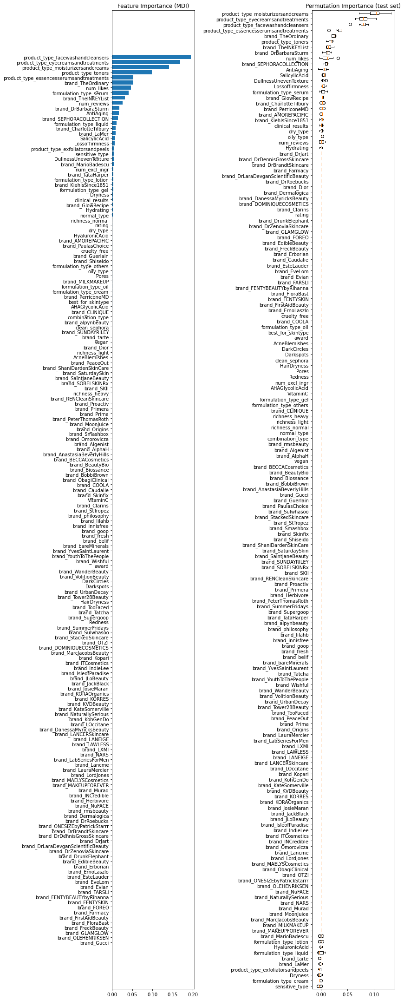

In [116]:
#Checking for one model 
from sklearn.inspection import permutation_importance
feature_importance = gb.feature_importances_
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
fig = plt.figure(figsize=(12, 30))
plt.subplot(1, 2, 1)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, np.array(X_tr.columns)[sorted_idx])
plt.title('Feature Importance (MDI)')

result = permutation_importance(gb, X_te, y_te, n_repeats=10,
                                random_state=42, n_jobs=2)
sorted_idx = result.importances_mean.argsort()
plt.subplot(1, 2, 2)
plt.boxplot(result.importances[sorted_idx].T,
            vert=False, labels=np.array(X_tr.columns)[sorted_idx])
plt.title("Permutation Importance (test set)")
fig.tight_layout()
plt.show()

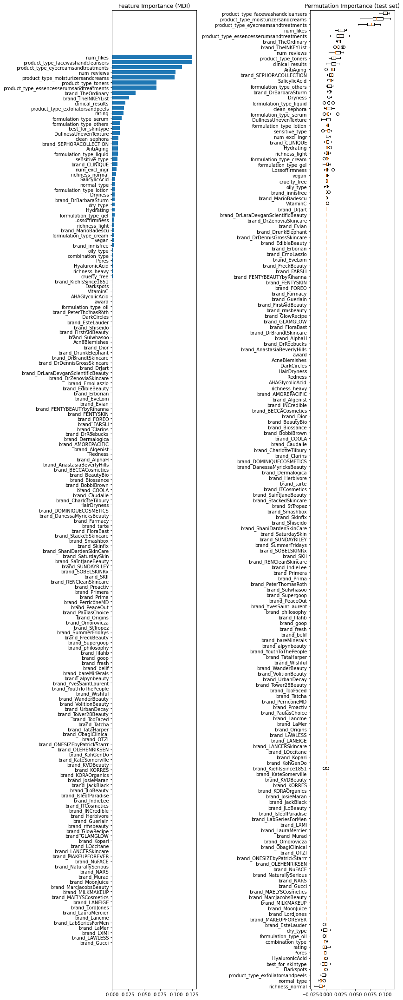

In [117]:
#Checking for another model 
from sklearn.inspection import permutation_importance
feature_importance = gb_opt.feature_importances_
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
fig = plt.figure(figsize=(12, 30))
plt.subplot(1, 2, 1)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, np.array(X_tr.columns)[sorted_idx])
plt.title('Feature Importance (MDI)')

result = permutation_importance(gb_opt, X_te, y_te, n_repeats=10,
                                random_state=42, n_jobs=2)
sorted_idx = result.importances_mean.argsort()
plt.subplot(1, 2, 2)
plt.boxplot(result.importances[sorted_idx].T,
            vert=False, labels=np.array(X_tr.columns)[sorted_idx])
plt.title("Permutation Importance (test set)")
fig.tight_layout()
plt.show()

<font color='red'> interesting results - it looks like a combination of rf selected features + LR/SVM important features!

### XGBoost

In [118]:
#! pip install xgboost

In [119]:
#! brew install libomp

In [120]:
from xgboost import XGBClassifier
import warnings
warnings.filterwarnings("ignore")

#### Training the model

In [121]:
xgb = XGBClassifier()
parameters = {
     "eta"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30 ] ,
     "max_depth"        : [ 3, 4, 5, 6, 8, 10, 12, 15],
     "min_child_weight" : [ 1, 3, 5, 7 ],
     "gamma"            : [ 0.0, 0.1, 0.2 , 0.3, 0.4 ],
     "colsample_bytree" : [ 0.3, 0.4, 0.5 , 0.7 ]
     }

In [122]:
#will be using nested cross validation to pick the parameters 
outer_results=[]
cv_outer = KFold(n_splits=5, shuffle=True, random_state=1)
#for each fold of the outer split
for train_ix, test_ix in cv_outer.split(X_tr):
    X_traintemp, X_testtemp = X_tr.iloc[train_ix, :], X_tr.iloc[test_ix, :]
    y_traintemp, y_testtemp = y_tr.iloc[train_ix], y_tr.iloc[test_ix]
        
    #create the inner loop - dividing the 
    cv_inner = KFold(n_splits=3, shuffle=True, random_state=1)
    
    #search = GridSearchCV(gb, param, scoring='accuracy', cv=cv_inner, refit=True)
    search = RandomizedSearchCV(xgb, parameters, scoring='accuracy', cv=cv_inner, refit=True)
            
    # find the best parameters
    result = search.fit(X_traintemp, y_traintemp)
        
    # use the best model found 
    best_model = result.best_estimator_
        
    # evaluate model
    yhat = best_model.predict(X_testtemp)
    acc = accuracy_score(y_testtemp, yhat)
    outer_results.append(acc)
    
    # report progress
    print('>acc=%.3f, best_estimator=%.3f, params=%s' % (acc, result.best_score_, result.best_params_))

    # summarize the estimated performance of the model
print('Average performance - accuracy: %.3f (+/- %.3f)' % (np.mean(outer_results), np.std(outer_results)))

[14:47:45] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:47:46] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:47:46] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:47:47] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

[14:47:58] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:47:59] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
>acc=0.670, best_estimator=0.714, params={'min_child_weight': 1, 'max_depth': 5, 'gamma': 0.0, 'eta': 0.05, 'colsample_bytree': 0.3}
[14:47:59] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:00] WARNING

[14:48:14] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:14] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

[14:48:31] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:31] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:31] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:32] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

[14:48:47] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:48] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:49] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:48:50] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

[14:49:09] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:09] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:10] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:10] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

- acc=0.754, best_estimator=0.670, params={'min_child_weight': 1, 'max_depth': 6, 'gamma': 0.0, 'eta': 0.25, 'colsample_bytree': 0.7}

- acc=0.706, best_estimator=0.698, params={'min_child_weight': 5, 'max_depth': 3, 'gamma': 0.1, 'eta': 0.1, 'colsample_bytree': 0.3}

- acc=0.654, best_estimator=0.713, params={'min_child_weight': 5, 'max_depth': 10, 'gamma': 0.3, 'eta': 0.05, 'colsample_bytree': 0.3}

- acc=0.749, best_estimator=0.694, params={'min_child_weight': 3, 'max_depth': 5, 'gamma': 0.2, 'eta': 0.05, 'colsample_bytree': 0.5}

- acc=0.711, best_estimator=0.713, params={'min_child_weight': 1, 'max_depth': 8, 'gamma': 0.4, 'eta': 0.05, 'colsample_bytree': 0.7}

Average performance - accuracy: 0.715 (+/- 0.036)

In [123]:
xgb1 = XGBClassifier(random_state=123, min_child_weight=1, max_depth=6, gamma=0.0, eta=0.25, colsample_bytree= 0.7)
xgb1.fit(X_tr, y_tr)

[14:49:13] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.7, eta=0.25, gamma=0.0,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=0.25, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=123, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [124]:
eval_model(xgb1, X_tr, y_tr, 5, scores_list, 'XGBoost1 - unscaled training set, tuned parameters', True, True)

[14:49:15] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:16] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:17] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:18] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

In [125]:
xgb2 = XGBClassifier(random_state=123, min_child_weight=5, max_depth=10, gamma=0.3, eta=0.05, colsample_bytree= 0.3)
xgb2.fit(X_tr, y_tr)

[14:49:20] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.3, eta=0.05, gamma=0.3,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=0.0500000007, max_delta_step=0, max_depth=10,
              min_child_weight=5, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=123, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [126]:
eval_model(xgb2, X_tr, y_tr, 5, scores_list, 'XGBoost - unscaled training set, tuned parameters', True, True)

[14:49:21] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:21] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:22] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:23] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

In [127]:
xgb_opt = XGBClassifier(random_state=123, min_child_weight=5, max_depth=3, gamma=0.2, eta=0.15, colsample_bytree= 0.4)
xgb_opt.fit(X_tr, y_tr) #to reduce overfitting

[14:49:24] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.4, eta=0.15, gamma=0.2,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=0.150000006, max_delta_step=0, max_depth=3,
              min_child_weight=5, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=123, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [128]:
eval_model(xgb_opt, X_tr, y_tr, 5, scores_list, 'XGBoost - unscaled training set, tuned parameters', True, True)

[14:49:25] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:25] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:25] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:49:26] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

#### Insights from the model

Which features are important in the XGBoost model?

Importance is calculated for a single decision tree by the amount that each attribute split point improves the performance measure, weighted by the number of observations the node is responsible for. The performance measure may be the purity (Gini index) used to select the split points or another more specific error function.

The feature importances are then averaged across all of the the decision trees within the model.

[14:49:27] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


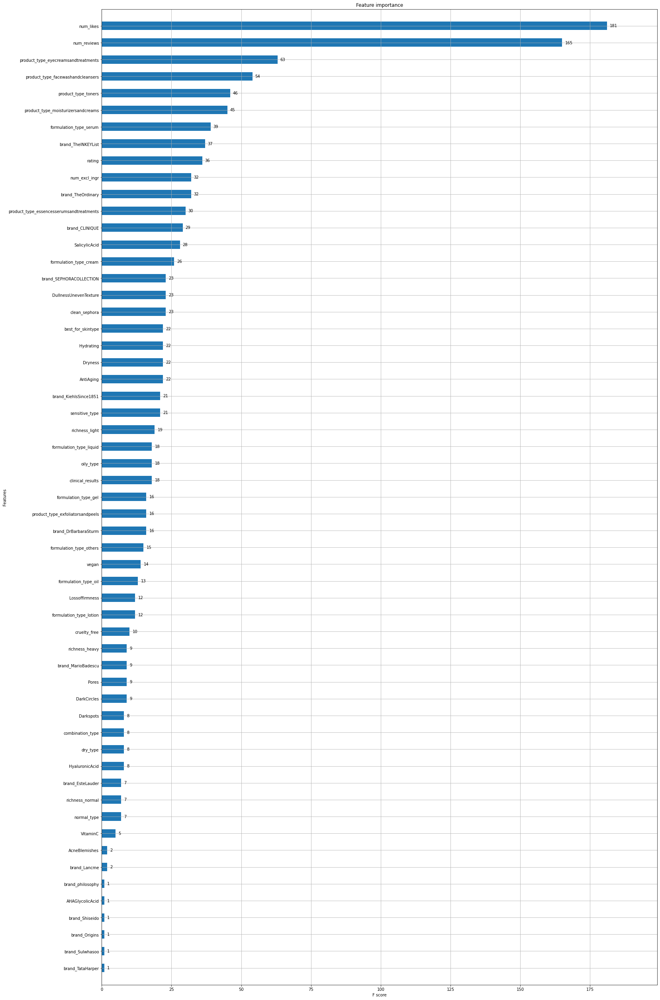

In [129]:
from xgboost import plot_importance
xgb_opt.fit(X_tr,y_tr)
ax= plot_importance(xgb_opt, max_num_features=100, height=0.5)
fig = ax.figure
fig.set_size_inches(25, 45)
plt.show();

In [130]:
# from xgboost import plot_tree
# plot_tree(xgb_opt)
# plt.show()

In [131]:
#xgb.to_graphviz(xgb_opt, num_trees=21, rankdir='LR')

## Reviewing the results

#### Review the various model performance

In [132]:
#Evaluation using cross validated measures only
model_cv = pd.DataFrame(cv_records).sort_values(by='Accuracy (CV test) mean', ascending=False)

#Top models
model_cv.iloc[:10, [0,1,2,3,4,5,7,9]]

,Description,Accuracy (CV test) mean,Accuracy (CV test) std,Accuracy (CV train) mean,Accuracy (CV train) std,Recall (CV test) mean,"Precision (weighted, CV) mean","F1 (weighted, CV) mean"
7,"SVM (linear) - scaled training set, selected f...",0.766066,0.034404,0.829062,0.007109,0.766066,0.770590,0.766034
3,"SVM - scaled training set, linear kernel",0.754318,0.035590,0.842418,0.011534,0.754318,0.757986,0.754644
9,"SVM - scaled training set, selected features u...",0.752173,0.040834,0.825858,0.008697,0.752173,0.757186,0.752488
10,LR - scaled SVM feature set,0.750063,0.040442,0.817576,0.007022,0.750063,0.754237,0.749815
1,LR - scaled and selected (based on LR chosen f...,0.745796,0.046211,0.816775,0.003005,0.745796,0.748574,0.744658
0,"LR - scaled training set, base (saga)",0.738304,0.035777,0.831465,0.009348,0.738304,0.740529,0.736470
8,"SVM - PCA features, linear",0.735078,0.027628,0.790338,0.013018,0.735078,0.739356,0.734686
2,"LR - PCA scaled training set, base model",0.721208,0.036772,0.786326,0.006776,0.721208,0.723839,0.719981
14,"RF - unscaled training set, tuned parameters",0.721186,0.035091,0.887824,0.007065,0.721186,0.723094,0.719929
15,"RF - unscaled training set, tuned parameters",0.719064,0.029854,0.999733,0.000534,0.719064,0.724041,0.718977


SVM and logistic regression performs best for this classification problem and training dataset.

In [133]:
print('Best model:',model_cv.iloc[0,0])

Best model: SVM (linear) - scaled training set, selected features using SVM


#### Evaluate results on test set

Also cross-checking model performance using Matthew's correlation coefficient

Accuracy score on test: 0.7412935323383084
Average ROC AUC score: 0.8078
{'cheap': 0.8391, 'expensive': 0.8438, 'average': 0.7406}
Classification report: 
               precision    recall  f1-score   support

     average       0.69      0.64      0.66       141
       cheap       0.82      0.76      0.79       136
   expensive       0.72      0.83      0.77       125

    accuracy                           0.74       402
   macro avg       0.74      0.75      0.74       402
weighted avg       0.74      0.74      0.74       402

Confusion matrix, without normalization:
[[ 90  18  33]
 [ 25 104   7]
 [ 16   5 104]]
Normalized confusion matrix:
[[0.64 0.13 0.23]
 [0.18 0.76 0.05]
 [0.13 0.04 0.83]]


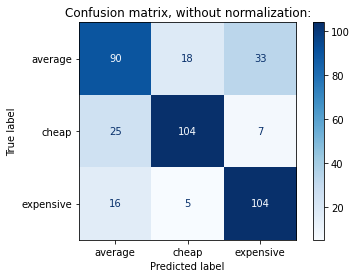

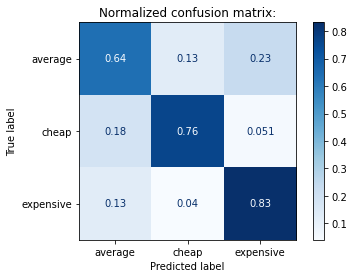

In [134]:
evaluate_test(linear, X_tr_sc_selectsvm, X_te_sc_selectsvm, y_tr, y_te, 'SVM - scaled training set, selected features using SVM', True)

In [135]:
#top model - SVM using selected svm scaled dataset
linear.fit(X_tr_sc_selectsvm, y_tr)
y_te_pred= linear.predict(X_te_sc_selectsvm)

In [136]:
matthews_corrcoef(y_te, y_te_pred)

0.6139325254284603

How did it rank the selected features?

Model:  SVC(decision_function_shape='ovo', kernel='linear', random_state=123)
Number of features displayed: 936/936
Number of features with 0 coef: 0


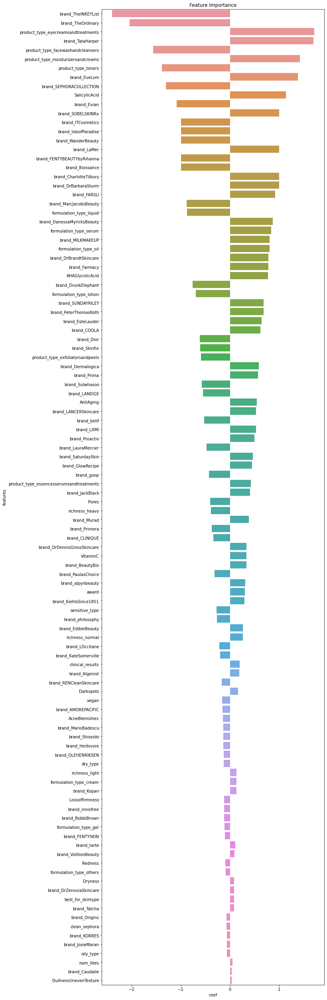

In [137]:
plot_feature_importance(linear, X_tr_sc_selectsvm, 'abs_value', (10,45))

> Honestly don't trust this as much as the first one!

______________________________________________________________________

## Saving the model and datasets

In [138]:
#Saving the training datasets
datapath = '../data/train_test'
datapath_df = os.path.join(datapath, 'train_scaled_svm.json')
if not os.path.exists(datapath_df):
    X_tr_sc_selectsvm.to_json(datapath_df) #for linear

In [145]:
datapath = '../data/train_test'
datapath_df = os.path.join(datapath, 'test_scaled_svm.json')
if not os.path.exists(datapath_df):
    X_te_sc_selectsvm.to_json(datapath_df) #for linear

In [259]:
#Saving the models
import pickle
datapath = '../model/'
datapath_df = os.path.join(datapath, 'svm_base.pkl')
if not os.path.exists(datapath_df):
    pickle.dump(linear, open('svm_base.pkl', 'wb'))

## Applying the model to predict under or overpricing

In [146]:
loaded_model = pickle.load(open('svm_base.pkl', 'rb'))
result = loaded_model.score(X_te_sc_selectsvm, y_te)
print(result)

0.7412935323383084


_______________

# *Extension:* Incorporating product ingredients

Are there specific ingredients that potentially drive up price?

## Loading the complementary dataset 

In [147]:
with open('../data/processed_data/ingr_count.json', 'r') as file:
    data= json.load(file)
ingr_count=pd.DataFrame.from_dict(data)

In [148]:
ingr_count.head()

,product_name,a,a blend of essential amino acids and calcium,abies pectinata leaf oil,abies sibirica oil,acacia dealbata flower stem extract,acacia decurrens flower wax,acacia decurrens jojoba sunflower seed wax polyglyceryl esters,acacia farnesiana flower wax,acacia honey,...,zinc palmitoyl nonapeptide,zinc pca,zinc ricinoleate,zinc sulfate,zingiber aromaticus extract,zingiber of cinale ginger root extract,zingiber officinale ginger extract,zingiber zerumbet extract,ziziphus jujuba fruit extract,zizyphus jujuba seed extract
0,Glow Recipe Watermelon Glow PHA +BHA Pore-Tigh...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Tatcha Pure One Step Camellia Oil Cleanser,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,goop GOOPGLOW Microderm Instant Glow Exfoliator,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,CLINIQUE Take The Day Off Makeup Remover For L...,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Tata Harper Regenerating Exfoliating Cleanser,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## Create new training datasets

Combining the ingredient counts to other training data sets

In [149]:
X_tr_fullingr = X_tr.join(ingr_count.drop(columns=['product_name']))
X_te_fullingr = X_te.join(ingr_count.drop(columns=['product_name']))

X_tr_sc_fullingr = X_tr_scaled.join(ingr_count.drop(columns=['product_name']))
X_te_sc_fullingr = X_te_scaled.join(ingr_count.drop(columns=['product_name']))

In [150]:
X_tr_sc_lringr = X_tr_sc_select.join(ingr_count.drop(columns=['product_name']))
X_te_sc_lringr = X_te_sc_select.join(ingr_count.drop(columns=['product_name']))
X_tr_lringr = X_tr_select.join(ingr_count.drop(columns=['product_name']))
X_te_lringr = X_te_select.join(ingr_count.drop(columns=['product_name']))

X_tr_svmingr = X_tr_selectsvm.join(ingr_count.drop(columns=['product_name']))
X_te_svmingr = X_te_selectsvm.join(ingr_count.drop(columns=['product_name']))
X_tr_sc_svmingr = X_tr_sc_selectsvm.join(ingr_count.drop(columns=['product_name']))
X_te_sc_svmingr = X_te_sc_selectsvm.join(ingr_count.drop(columns=['product_name']))

## Modelling

### Utilising existing models from part 1

#### SVM

In [151]:
eval_model(linear, X_tr_sc_fullingr, y_tr, 5, scores_list, 'SVM - full scaled with ingr count, linear', True)

SVM - full scaled with ingr count, linear

Test scores: (mean, SD)
 Accuracy: 
 (0.6955, 0.0273)
 F1_Weighted: 
 (0.6977, 0.0275)
 Precision_Weighted: 
 (0.7055, 0.029)
 Recall_Weighted: 
 (0.6955, 0.0273)

Training scores:
 Accuracy: 
 (0.9979, 0.0011)
 F1_Weighted: 
 (0.9979, 0.0011)
 Precision_Weighted: 
 (0.9979, 0.0011)
 Recall_Weighted: 
 (0.9979, 0.0011)


In [152]:
eval_model(linear, X_tr_sc_lringr, y_tr, 5, scores_list, 'SVM - scaled LR feature set with ingr, linear', True)

SVM - scaled LR feature set with ingr, linear

Test scores: (mean, SD)
 Accuracy: 
 (0.702, 0.0359)
 F1_Weighted: 
 (0.7038, 0.0365)
 Precision_Weighted: 
 (0.7117, 0.0391)
 Recall_Weighted: 
 (0.702, 0.0359)

Training scores:
 Accuracy: 
 (0.9979, 0.0007)
 F1_Weighted: 
 (0.9979, 0.0007)
 Precision_Weighted: 
 (0.9979, 0.0007)
 Recall_Weighted: 
 (0.9979, 0.0007)


In [153]:
eval_model(linear, X_tr_sc_svmingr, y_tr, 5, scores_list, 'SVM - scaled SVM feature set with ingr, linear', True)

SVM - scaled SVM feature set with ingr, linear

Test scores: (mean, SD)
 Accuracy: 
 (0.7084, 0.0287)
 F1_Weighted: 
 (0.7106, 0.0286)
 Precision_Weighted: 
 (0.7176, 0.0304)
 Recall_Weighted: 
 (0.7084, 0.0287)

Training scores:
 Accuracy: 
 (0.9979, 0.0011)
 F1_Weighted: 
 (0.9979, 0.0011)
 Precision_Weighted: 
 (0.9979, 0.0011)
 Recall_Weighted: 
 (0.9979, 0.0011)


#### Logistic regression 

In [154]:
eval_model(logreg, X_tr_sc_fullingr, y_tr, 5, scores_list, 'LR - scaled full feature set with ingr', True)

LR - scaled full feature set with ingr

Test scores: (mean, SD)
 Accuracy: 
 (0.7115, 0.0476)
 F1_Weighted: 
 (0.7108, 0.0495)
 Precision_Weighted: 
 (0.7136, 0.0514)
 Recall_Weighted: 
 (0.7115, 0.0476)

Training scores:
 Accuracy: 
 (0.9976, 0.001)
 F1_Weighted: 
 (0.9976, 0.001)
 Precision_Weighted: 
 (0.9976, 0.001)
 Recall_Weighted: 
 (0.9976, 0.001)


In [155]:
eval_model(logreg, X_tr_sc_lringr, y_tr, 5, scores_list, 'LR - scaled LR feature set with ingr', True)

LR - scaled LR feature set with ingr

Test scores: (mean, SD)
 Accuracy: 
 (0.7222, 0.0522)
 F1_Weighted: 
 (0.7212, 0.0546)
 Precision_Weighted: 
 (0.7229, 0.0569)
 Recall_Weighted: 
 (0.7222, 0.0522)

Training scores:
 Accuracy: 
 (0.9973, 0.0008)
 F1_Weighted: 
 (0.9973, 0.0008)
 Precision_Weighted: 
 (0.9973, 0.0008)
 Recall_Weighted: 
 (0.9973, 0.0008)


In [156]:
eval_model(logreg, X_tr_sc_svmingr, y_tr, 5, scores_list, 'LR - scaled SVM feature set with ingr', True)

LR - scaled SVM feature set with ingr

Test scores: (mean, SD)
 Accuracy: 
 (0.7222, 0.0503)
 F1_Weighted: 
 (0.7219, 0.0518)
 Precision_Weighted: 
 (0.724, 0.0542)
 Recall_Weighted: 
 (0.7222, 0.0503)

Training scores:
 Accuracy: 
 (0.9976, 0.001)
 F1_Weighted: 
 (0.9976, 0.001)
 Precision_Weighted: 
 (0.9976, 0.001)
 Recall_Weighted: 
 (0.9976, 0.001)


The models are able to achieve similar a performance range at c. 70% even with a significantly larger dataset. However, the models are overfitting on the dataset. 

(not yet clear on how the models are using the ingredients for the prediction; possible that it is mostly ignoring the ingredients)

#### RandomForest

In [157]:
eval_model(rf2, X_tr_fullingr, y_tr, 5, scores_list, 'RF - full feature set with ingr, tuned parameters', True)

RF - full feature set with ingr, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.6838, 0.0416)
 F1_Weighted: 
 (0.6737, 0.0415)
 Precision_Weighted: 
 (0.69, 0.0494)
 Recall_Weighted: 
 (0.6838, 0.0416)

Training scores:
 Accuracy: 
 (0.8312, 0.0126)
 F1_Weighted: 
 (0.8297, 0.0132)
 Precision_Weighted: 
 (0.8451, 0.0119)
 Recall_Weighted: 
 (0.8312, 0.0126)


In [158]:
eval_model(rf2, X_tr_lringr, y_tr, 5, scores_list, 'RF - scaled LR feature set with ingr', True)

RF - scaled LR feature set with ingr

Test scores: (mean, SD)
 Accuracy: 
 (0.6785, 0.0264)
 F1_Weighted: 
 (0.6682, 0.0275)
 Precision_Weighted: 
 (0.686, 0.0287)
 Recall_Weighted: 
 (0.6785, 0.0264)

Training scores:
 Accuracy: 
 (0.8189, 0.0056)
 F1_Weighted: 
 (0.819, 0.005)
 Precision_Weighted: 
 (0.837, 0.0069)
 Recall_Weighted: 
 (0.8189, 0.0056)


In [159]:
eval_model(rf2, X_tr_svmingr, y_tr, 5, scores_list, 'RF - scaled SVM feature set with ingr', True)

RF - scaled SVM feature set with ingr

Test scores: (mean, SD)
 Accuracy: 
 (0.6752, 0.0159)
 F1_Weighted: 
 (0.6635, 0.0178)
 Precision_Weighted: 
 (0.6804, 0.021)
 Recall_Weighted: 
 (0.6752, 0.0159)

Training scores:
 Accuracy: 
 (0.8208, 0.0058)
 F1_Weighted: 
 (0.8188, 0.0062)
 Precision_Weighted: 
 (0.8392, 0.0094)
 Recall_Weighted: 
 (0.8208, 0.0058)


#### XGBoost

In [160]:
eval_model(xgb_opt, X_tr_fullingr, y_tr, 5, scores_list, 'XGB - full feature set with ingr, tuned parameters', True)

[15:01:45] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:01:53] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:02:01] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:02:08] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

In [161]:
eval_model(xgb1, X_tr_fullingr, y_tr, 5, scores_list, 'XGB - full feature set with ingr, tuned parameters', True)

[15:02:22] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:02:42] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:03:02] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:03:21] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

Interesting that the XGB models have performed better on a bigger dataset although it overfits also on the training.

In [162]:
eval_model(xgb1, X_tr_lringr, y_tr, 5, scores_list, 'XGB - LR set with ingr, tuned parameters', True)

[15:04:12] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:04:36] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:04:55] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:05:14] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

In [163]:
eval_model(xgb_opt, X_tr_svmingr, y_tr, 5, scores_list, 'XGB - SVM set with ingr, tuned parameters', True)

[15:06:00] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:06:07] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:06:14] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:06:21] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

<NOTE> 

#### Gradient boosting

In [164]:
eval_model(gb, X_tr_fullingr, y_tr, 5, scores_list, 'GB - full feature set with ingr, tuned parameters', True)

GB - full feature set with ingr, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.7169, 0.0364)
 F1_Weighted: 
 (0.7186, 0.0371)
 Precision_Weighted: 
 (0.7313, 0.0421)
 Recall_Weighted: 
 (0.7169, 0.0364)

Training scores:
 Accuracy: 
 (0.8053, 0.006)
 F1_Weighted: 
 (0.8071, 0.0051)
 Precision_Weighted: 
 (0.8134, 0.0037)
 Recall_Weighted: 
 (0.8053, 0.006)


In [165]:
eval_model(gb, X_tr_svmingr, y_tr, 5, scores_list, 'GB - SVM set with ingr, tuned parameters', True)

GB - SVM set with ingr, tuned parameters

Test scores: (mean, SD)
 Accuracy: 
 (0.718, 0.0385)
 F1_Weighted: 
 (0.7196, 0.0394)
 Precision_Weighted: 
 (0.732, 0.044)
 Recall_Weighted: 
 (0.718, 0.0385)

Training scores:
 Accuracy: 
 (0.8074, 0.0045)
 F1_Weighted: 
 (0.8091, 0.0036)
 Precision_Weighted: 
 (0.8151, 0.0015)
 Recall_Weighted: 
 (0.8074, 0.0045)


### Retraining selected models

Evaluate selected models on the test set with ingredient count. Generally, the XGB and the GB models have performed better.

*A. XGB*

In [166]:
xgb_tune = XGBClassifier(random_state=123)
param_xg = {
     "eta"    : [0.05, 0.10, 0.15, 0.20, 0.25, 0.30 ] ,
     "max_depth"        : [ 3, 4, 5, 6, 8, 10, 12, 15],
     "min_child_weight" : [ 1, 3, 5, 7 ],
     "gamma"            : [ 0.0, 0.1, 0.2 , 0.3, 0.4 ],
     "colsample_bytree" : [ 0.3, 0.4, 0.5 , 0.7 ]
     }

In [167]:
#will be using nested cross validation to pick the parameters 
outer_results=[]
cv_outer = KFold(n_splits=5, shuffle=True, random_state=1)
#for each fold of the outer split
for train_ix, test_ix in cv_outer.split(X_tr_fullingr):
    X_traintemp, X_testtemp = X_tr.iloc[train_ix, :], X_tr.iloc[test_ix, :]
    y_traintemp, y_testtemp = y_tr.iloc[train_ix], y_tr.iloc[test_ix]
        
    #create the inner loop - dividing the 
    cv_inner = KFold(n_splits=3, shuffle=True, random_state=1)
    
    print('Executing search..')
    #search = GridSearchCV(gb, param, scoring='accuracy', cv=cv_inner, refit=True)
    search = RandomizedSearchCV(xgb_tune, param_xg, scoring='accuracy', cv=cv_inner, refit=True)
            
    # find the best parameters
    result = search.fit(X_traintemp, y_traintemp)
        
    # use the best model found 
    best_model = result.best_estimator_
        
    # evaluate model
    yhat = best_model.predict(X_testtemp)
    acc = accuracy_score(y_testtemp, yhat)
    outer_results.append(acc)
    
    # report progress
    print('>acc=%.3f, best_estimator=%.3f, params=%s' % (acc, result.best_score_, result.best_params_))

    # summarize the estimated performance of the model
print('Average performance - accuracy: %.3f (+/- %.3f)' % (np.mean(outer_results), np.std(outer_results)))

Executing search..
[15:10:11] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:11] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:11] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:12] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric u

[15:10:27] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:27] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
>acc=0.707, best_estimator=0.721, params={'min_child_weight': 1, 'max_depth': 3, 'gamma': 0.3, 'eta': 0.2, 'colsample_bytree': 0.5}
Executing search..
[15:10:28] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


[15:10:41] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:42] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:43] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:44] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

[15:10:57] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:58] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:58] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:10:59] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

[15:11:16] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:11:16] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:11:17] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:11:17] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

[15:11:29] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:11:29] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:11:29] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:11:30] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

- acc=0.743, best_estimator=0.672, params={'min_child_weight': 3, 'max_depth': 6, 'gamma': 0.0, 'eta': 0.1, 'colsample_bytree': 0.5}
- acc=0.684, best_estimator=0.706, params={'min_child_weight': 3, 'max_depth': 3, 'gamma': 0.3, 'eta': 0.05, 'colsample_bytree': 0.7}
- acc=0.686, best_estimator=0.709, params={'min_child_weight': 1, 'max_depth': 5, 'gamma': 0.1, 'eta': 0.15, 'colsample_bytree': 0.5}
- acc=0.722, best_estimator=0.712, params={'min_child_weight': 1, 'max_depth': 6, 'gamma': 0.3, 'eta': 0.1, 'colsample_bytree': 0.3}
- acc=0.706, best_estimator=0.712, params={'min_child_weight': 1, 'max_depth': 5, 'gamma': 0.4, 'eta': 0.05, 'colsample_bytree': 0.4}

Average performance - accuracy: 0.708 (+/- 0.022)

In [168]:
#Build xgb model with tuned parameters
xgb_new1 = XGBClassifier(random_state=123, min_child_weight= 3, 
                            max_depth= 6, 
                            gamma= 0, 
                            eta= 0.1, 
                            colsample_bytree= 0.5)
xgb_new1.fit(X_tr_fullingr, y_tr)

[15:11:34] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.5, eta=0.1, gamma=0,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=0.100000001, max_delta_step=0, max_depth=6,
              min_child_weight=3, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=123, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [169]:
#Build xgb model with tuned parameters
xgb_new2 = XGBClassifier(random_state=123, min_child_weight= 1, 
                            max_depth= 6, 
                            gamma= 0.3, 
                            eta= 0.1, 
                            colsample_bytree= 0.3)
xgb_new2.fit(X_tr_fullingr, y_tr)

[15:11:53] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.3, eta=0.1, gamma=0.3,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=0.100000001, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=123, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [170]:
eval_model(xgb_new1, X_tr_fullingr, y_tr, 5, scores_list, 'XGB1 - full feature set with ingr, tuned parameters', True)

[15:12:05] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:12:19] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:12:36] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:12:50] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

In [171]:
eval_model(xgb_new2, X_tr_fullingr, y_tr, 5, scores_list, 'XGB1 - full feature set with ingr, tuned parameters', True)

[15:13:20] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:13:34] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:13:46] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[15:13:56] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the object

> What do i do now since it's overfitting...
- restrict depth, tune hyperparameters

*B. GB models*

In [172]:
param_gb2={
    'loss':['deviance', 'exponential'],
    'n_estimators':[50, 100, 150, 250],
    'max_depth': [3, 7, 11, 15],
    'learning_rate':[0.01, 0.1, 0.25, 0.5, 0.75, 1],
    'subsample':[0.5, 1],
    'min_samples_split':[4, 7, 10],
    'min_samples_leaf': [5, 10, 20]
}

gb_tune= GradientBoostingClassifier(random_state=123)

In [173]:
#will be using nested cross validation to pick the parameters 
outer_results=[]
cv_outer = KFold(n_splits=5, shuffle=True, random_state=1)
#for each fold of the outer split
for train_ix, test_ix in cv_outer.split(X_tr_fullingr):
    X_traintemp, X_testtemp = X_tr.iloc[train_ix, :], X_tr.iloc[test_ix, :]
    y_traintemp, y_testtemp = y_tr.iloc[train_ix], y_tr.iloc[test_ix]
        
    #create the inner loop - dividing the 
    cv_inner = KFold(n_splits=3, shuffle=True, random_state=1)
    
    #print('______________________EXECUTING SEARCH________________________')
    #search = GridSearchCV(gb, param, scoring='accuracy', cv=cv_inner, refit=True)
    search = RandomizedSearchCV(gb_tune, param_gb2, scoring='accuracy', cv=cv_inner, refit=True)
            
    # find the best parameters
    result = search.fit(X_traintemp, y_traintemp)
        
    # use the best model found 
    best_model = result.best_estimator_
        
    # evaluate model
    yhat = best_model.predict(X_testtemp)
    acc = accuracy_score(y_testtemp, yhat)
    outer_results.append(acc)
    
    # report progress
    print('>acc=%.3f, best_estimator=%.3f, params=%s' % (acc, result.best_score_, result.best_params_))

    # summarize the estimated performance of the model
print('Average performance - accuracy: %.3f (+/- %.3f)' % (np.mean(outer_results), np.std(outer_results)))

>acc=0.665, best_estimator=0.678, params={'subsample': 1, 'n_estimators': 250, 'min_samples_split': 10, 'min_samples_leaf': 10, 'max_depth': 3, 'loss': 'deviance', 'learning_rate': 0.5}
>acc=0.690, best_estimator=0.686, params={'subsample': 0.5, 'n_estimators': 250, 'min_samples_split': 10, 'min_samples_leaf': 5, 'max_depth': 7, 'loss': 'deviance', 'learning_rate': 0.01}
>acc=0.690, best_estimator=0.678, params={'subsample': 1, 'n_estimators': 250, 'min_samples_split': 4, 'min_samples_leaf': 5, 'max_depth': 7, 'loss': 'deviance', 'learning_rate': 1}
>acc=0.679, best_estimator=0.684, params={'subsample': 1, 'n_estimators': 150, 'min_samples_split': 10, 'min_samples_leaf': 20, 'max_depth': 3, 'loss': 'deviance', 'learning_rate': 0.1}
>acc=0.690, best_estimator=0.653, params={'subsample': 1, 'n_estimators': 150, 'min_samples_split': 10, 'min_samples_leaf': 5, 'max_depth': 7, 'loss': 'deviance', 'learning_rate': 0.75}
Average performance - accuracy: 0.683 (+/- 0.010)


Average performance here is less than the XGB.

### Evaluating model performance

[15:15:36] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy score on test: 0.7611940298507462
Average ROC AUC score: 0.8228
{'cheap': 0.8614, 'expensive': 0.85, 'average': 0.757}
Classification report: 
               precision    recall  f1-score   support

     average       0.71      0.66      0.68       141
       cheap       0.86      0.79      0.82       136
   expensive       0.72      0.85      0.78       125

    accuracy                           0.76       402
   macro avg       0.76      0.76      0.76       402
weighted avg       0.77      0.76      0.76       402

Confusion matrix, without normalization:
[[ 93  14  34]
 [ 22 107   7]
 [ 16   3 106]]
Normalized confusion matrix:
[[0.66 0.1  0.24]
 [0.16 0.79 0.05]
 [0.13 0.02 0.85]]


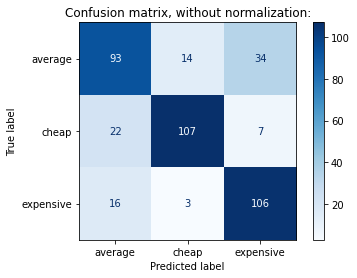

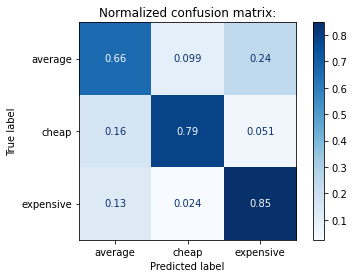

In [174]:
evaluate_test(xgb_new2, X_tr_fullingr, X_te_fullingr, y_tr, y_te, 'XGB_new2 - full feature set with ingr, tuned parameters', True)

### Model interpretability

#### Feature importance

Are some ingredients more predictive than others? 

[15:15:53] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


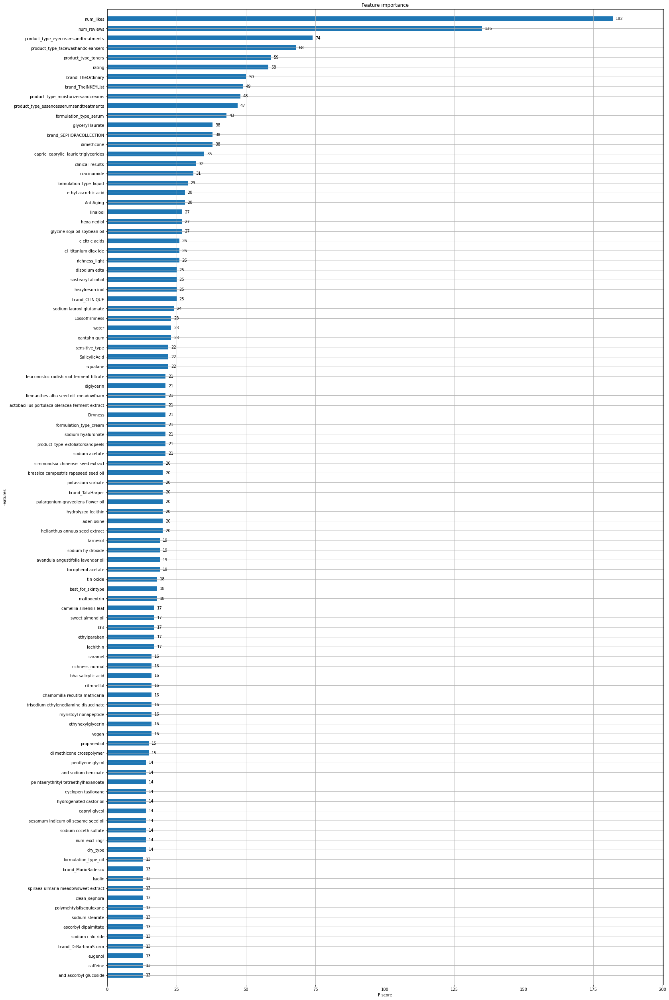

In [175]:
xgb_new2.fit(X_tr_fullingr,y_tr)
ax= plot_importance(xgb_new2, max_num_features=100, height=0.5)
fig = ax.figure
fig.set_size_inches(25, 45)
plt.show();

#### SHAP

In [176]:
#! pip install shap

*A. General model*

In [177]:
explainer = shap.TreeExplainer(xgb_new2, X_tr_fullingr)
shap_values = explainer.shap_values(X_tr_fullingr)
plt.show()

 98%|===================| 2743/2808 [00:17<00:00]        

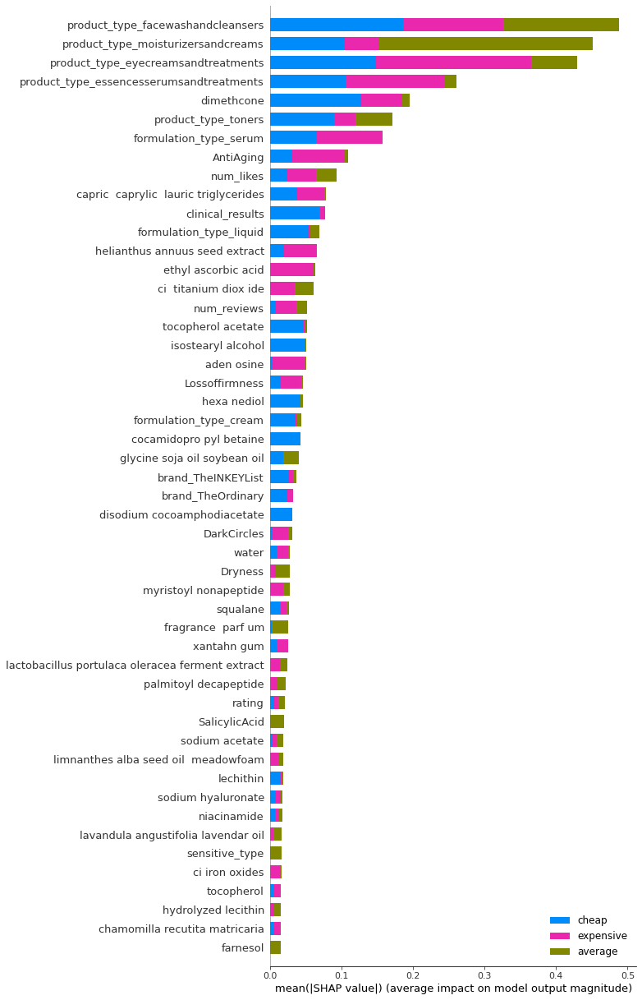

In [178]:
class_names = ["average", "cheap", "expensive"]
shap.summary_plot(shap_values, X_tr_fullingr, max_display= 50, plot_type='bar', class_names= class_names)

*B. Explaining individual predictions*

In [179]:
#take a random row of data
X_rand = X_te_fullingr.sample(1, random_state = 5)
idx = X_rand.index[0]
display(df1.loc[[idx]])

#generate a prediction for the row
rand_pred = xgb_new2.predict(X_rand)
rand_proba = xgb_new2.predict_proba(X_rand)

print(f'Predicted Probability for each class: {rand_proba}')
print(f'Predicted Class: {rand_pred}')
print(f'Actual classification: {df.price_category[X_rand.index][0]}')
print(f'Actual price per volume: ${df1.pricepervol[X_rand.index][0]}')


,product_name,num_likes,rating,num_reviews,sensitive_type,combination_type,oily_type,normal_type,dry_type,clean_sephora,...,brand_belif,brand_fresh,brand_goop,brand_innisfree,brand_lilahb,brand_philosophy,brand_rmsbeauty,brand_tarte,affordability,price_category
740,Shiseido Bio-Performance Glow Revival Cream,6000,5.0,39,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,$$$,expensive


Predicted Probability for each class: [[0.35 0.05 0.61]]
Predicted Class: ['expensive']
Actual classification: expensive
Actual price per volume: $64.7058823529


In [180]:
# Initialize JavaScript visualizations in notebook environment
shap.initjs()
# Define a tree explainer for the built model
explainer = shap.TreeExplainer(xgb_new2)
# obtain shap values for the row of the test data
shap_values = explainer.shap_values(X_te_fullingr.loc[[idx]])

shap.initjs()
for which_class in range(0,3):
    display(shap.force_plot(explainer.expected_value[which_class], shap_values[which_class], X_te_fullingr.loc[[idx]]))

In [181]:
def explain_instance(prod, model, test_set):
    '''
    
    '''
    idx= df1.loc[df1.product_name==prod].index[0]
    X = test_set.loc[[idx]]
    #generate a prediction for the row
    rand_pred = model.predict(X)
    rand_proba = model.predict_proba(X)

    print(f'Predicted Probability for each class: {rand_proba}')
    print(f'Predicted Class: {rand_pred}')
    print(f'Actual classification: {df.price_category[X.index][0]}')
    print(f'Actual price per volume: ${df1.pricepervol[X.index][0]}')

    shap.initjs()
    # Define a tree explainer for the built model
    explainer2 = shap.TreeExplainer(model)
    # obtain shap values for the row of the test data
    shap_values2 = explainer2.shap_values(test_set.loc[[idx]])

    class_names= ['average', 'cheap', 'expensive']
    shap.initjs()
    for which_class in range(0,3):
        print('PREDICTION FOR ', class_names[which_class].upper())
        display(shap.force_plot(explainer2.expected_value[which_class], shap_values2[which_class], test_set.loc[[idx]]))

In [182]:
#Retrieve list of test product names
test_prods = X_te_fullingr.index.to_list()
df1.loc[test_prods].product_name.to_list()

["Kiehl's Since 1851 Dermatologist Solutions™ Centella Sensitive Cica-Cream",
 'IT Cosmetics Bye Bye Lines Anti-Aging Serum',
 'Estée Lauder Advanced Night Repair Eye Concentrate Matrix',
 'Lancôme Hydra Zen Anti-Stress Moisturizing Face Cream',
 'Summer Fridays Soft Reset AHA Exfoliating Solution',
 'Dr. Dennis Gross Skincare Clinical Grade IPL Dark Spot Correcting Serum',
 'Naturally Serious Zero Baggage Anti-Dark Circle Eye Cream',
 'CLINIQUE Acne Solutions™ Cleansing Foam',
 'Dr. Zenovia Skincare Aloe Vera Blemish Soothing Moisturizer',
 'Clarins Lotus Face Treatment Oil',
 'Skinfix Barrier+ Triple Lipid-Peptide Face Lotion',
 'Dr. Brandt Skincare 2% Retinol Complex Serum',
 'KORRES Pomegranate Pore Blurring Gel Moisturizer',
 'FENTY SKIN Instant Reset Overnight Recovery Gel-Cream',
 'innisfree Green Tea Hydrating Sleeping Mask',
 'AMOREPACIFIC Intensive Vitalizing Eye Essence',
 'Supergoop! Bright-Eyed 100% Mineral Eye Cream SPF 40',
 'Shiseido WASO: Fresh Jelly Essence',
 'Saint 

Inspecting some outputs - both correct and misclassified...

In [183]:
explain_instance('Dr. Lara Devgan Scientific Beauty Hyaluronic Serum', xgb_new2, X_te_fullingr)

Predicted Probability for each class: [[0.13 0.03 0.84]]
Predicted Class: ['expensive']
Actual classification: expensive
Actual price per volume: $245.0


PREDICTION FOR  AVERAGE


PREDICTION FOR  CHEAP


PREDICTION FOR  EXPENSIVE


In [184]:
explain_instance('Caudalie VinoClean Deep Cleansing Exfoliator', xgb_new2, X_te_fullingr)

Predicted Probability for each class: [[0.2  0.59 0.21]]
Predicted Class: ['cheap']
Actual classification: cheap
Actual price per volume: $14.0


PREDICTION FOR  AVERAGE


PREDICTION FOR  CHEAP


PREDICTION FOR  EXPENSIVE


In [185]:
explain_instance('MAELYS Cosmetics B-PERKY Lift & Firm Breast Mask', xgb_new2, X_te_fullingr)

Predicted Probability for each class: [[0.45 0.1  0.45]]
Predicted Class: ['expensive']
Actual classification: cheap
Actual price per volume: $11.5384615385


PREDICTION FOR  AVERAGE


PREDICTION FOR  CHEAP


PREDICTION FOR  EXPENSIVE


In [235]:
#Let's inspect an instance it got wrong
explain_instance("L'Occitane Aqua Reotier Ultra Thirst-Quenching Cream Moisturizer", xgb_new2, X_te_fullingr)

Predicted Probability for each class: [[0.66 0.2  0.14]]
Predicted Class: ['average']
Actual classification: average
Actual price per volume: $18.8235294118


PREDICTION FOR  AVERAGE


PREDICTION FOR  CHEAP


PREDICTION FOR  EXPENSIVE


In [187]:
#Let's inspect an instance it got wrong
explain_instance('Youth To The People Superberry Hydrate + Glow Dream Oil', xgb_new2, X_te_fullingr)

Predicted Probability for each class: [[0.29 0.13 0.58]]
Predicted Class: ['expensive']
Actual classification: average
Actual price per volume: $44.0


PREDICTION FOR  AVERAGE


PREDICTION FOR  CHEAP


PREDICTION FOR  EXPENSIVE


In [188]:
explain_instance('Algenist Pore Corrector Anti-Aging Primer', xgb_new2, X_te_fullingr)

Predicted Probability for each class: [[0.42 0.15 0.43]]
Predicted Class: ['expensive']
Actual classification: average
Actual price per volume: $42.0


PREDICTION FOR  AVERAGE


PREDICTION FOR  CHEAP


PREDICTION FOR  EXPENSIVE


## Train on entire dataset

In [224]:
#Combine dataset
X_complete = X.join(ingr_count.drop(columns=['product_name']))

In [226]:
#Train on entire dataset
xgb_new2.fit(X_complete, y)

[18:24:21] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=0.3, eta=0.1, gamma=0.3,
              gpu_id=-1, importance_type='gain', interaction_constraints='',
              learning_rate=0.100000001, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=123, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

## Saving the model and datasets

In [190]:
#Saving the training datasets
datapath = '../data/train_test'
datapath_df = os.path.join(datapath, 'train_complete.json')
#if not os.path.exists(datapath_df):
X_tr_fullingr.to_json(datapath_df) 

In [191]:
datapath = '../data/train_test'
datapath_df = os.path.join(datapath, 'test_complete.json')
#if not os.path.exists(datapath_df):
X_te_fullingr.to_json(datapath_df) 

In [227]:
datapath = '../data/train_test'
datapath_df = os.path.join(datapath, 'x_complete.json')
#if not os.path.exists(datapath_df):
X_complete.to_json(datapath_df) 

In [228]:
datapath = '../data/train_test'
datapath_df = os.path.join(datapath, 'y_complete.json')
#if not os.path.exists(datapath_df):
y.to_json(datapath_df) 

In [258]:
#Saving the model
datapath_df = os.path.join('../model', 'xgb_final.pkl')
if not os.path.exists(datapath_df):
    pickle.dump(xgb_new2, open('xgb_final.pkl', 'wb'))

## See output of final model

In [231]:
model = pickle.load(open('xgb_final.pkl','rb'))

**General model**

In [246]:
explainer = shap.TreeExplainer(model, X_complete)
shap_values = explainer.shap_values(X_complete)
plt.show()

 95%|=================== | 3833/4014 [00:17<00:00]       

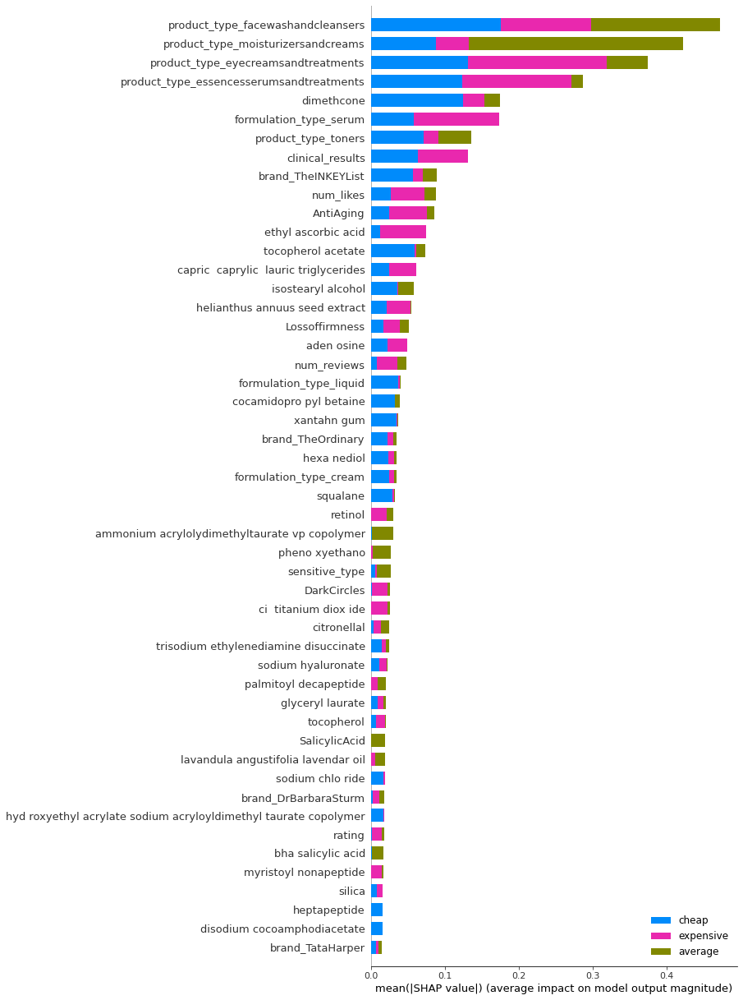

In [247]:
class_names = ["average", "cheap", "expensive"]
shap.summary_plot(shap_values, X_complete, max_display= 50, plot_type='bar', class_names= class_names)

**Individual predictions**

In [234]:
#Let's inspect an instance it got wrong
explain_instance('Youth To The People Superberry Hydrate + Glow Dream Oil', model, X_complete)

Predicted Probability for each class: [[0.65 0.13 0.23]]
Predicted Class: ['average']
Actual classification: average
Actual price per volume: $44.0


PREDICTION FOR  AVERAGE


PREDICTION FOR  CHEAP


PREDICTION FOR  EXPENSIVE


In [233]:
explain_instance('Algenist Pore Corrector Anti-Aging Primer', model, X_complete)

Predicted Probability for each class: [[0.67 0.11 0.22]]
Predicted Class: ['average']
Actual classification: average
Actual price per volume: $42.0


PREDICTION FOR  AVERAGE


PREDICTION FOR  CHEAP


PREDICTION FOR  EXPENSIVE


_____________________________________

# Final remarks

few thoughts on the next steps / future variations of the study

remove brand as a predictor of affordability - without thinking about brand/product positioning, how would the product price prediction change?

*Can we improve the model further by increasing the training data set?*

In [252]:
#code adapted from documentation
def plot_learning_curve(estimator, title, X, y, axes=None, ylim=None, cv=None,
                        n_jobs=None, train_sizes=np.linspace(.1, 1.0, 5)):
    """
    Generate 3 plots: the test and training learning curve, the training
    samples vs fit times curve, the fit times vs score curve.

    Parameters
    ----------
    estimator : estimator instance
        An estimator instance implementing `fit` and `predict` methods which
        will be cloned for each validation.

    title : str
        Title for the chart.

    X : array-like of shape (n_samples, n_features)
        Training vector, where ``n_samples`` is the number of samples and
        ``n_features`` is the number of features.

    y : array-like of shape (n_samples) or (n_samples, n_features)
        Target relative to ``X`` for classification or regression;
        None for unsupervised learning.

    axes : array-like of shape (3,), default=None
        Axes to use for plotting the curves.

    ylim : tuple of shape (2,), default=None
        Defines minimum and maximum y-values plotted, e.g. (ymin, ymax).

    cv : int, cross-validation generator or an iterable, default=None
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:

          - None, to use the default 5-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, default=None
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    train_sizes : array-like of shape (n_ticks,)
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the ``dtype`` is float, it is regarded
        as a fraction of the maximum size of the training set (that is
        determined by the selected validation method), i.e. it has to be within
        (0, 1]. Otherwise it is interpreted as absolute sizes of the training
        sets. Note that for classification the number of samples usually have
        to be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    if axes is None:
        _, axes = plt.subplots(1, 3, figsize=(20, 5))

    axes[0].set_title(title)
    if ylim is not None:
        axes[0].set_ylim(*ylim)
    axes[0].set_xlabel("Training examples")
    axes[0].set_ylabel("Score")

    train_sizes, train_scores, test_scores, fit_times, _ = \
        learning_curve(estimator, X, y, cv=cv, n_jobs=n_jobs,
                       train_sizes=train_sizes,
                       return_times=True)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    fit_times_mean = np.mean(fit_times, axis=1)
    fit_times_std = np.std(fit_times, axis=1)

    # Plot learning curve
    axes[0].grid()
    axes[0].fill_between(train_sizes, train_scores_mean - train_scores_std,
                         train_scores_mean + train_scores_std, alpha=0.1,
                         color="r")
    axes[0].fill_between(train_sizes, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1,
                         color="g")
    axes[0].plot(train_sizes, train_scores_mean, 'o-', color="r",
                 label="Training score")
    axes[0].plot(train_sizes, test_scores_mean, 'o-', color="g",
                 label="Cross-validated test score")
    axes[0].legend(loc="best")

    # Plot n_samples vs fit_times
    axes[1].grid()
    axes[1].plot(train_sizes, fit_times_mean, 'o-')
    axes[1].fill_between(train_sizes, fit_times_mean - fit_times_std,
                         fit_times_mean + fit_times_std, alpha=0.1)
    axes[1].set_xlabel("Training examples")
    axes[1].set_ylabel("fit_times")
    axes[1].set_title("Scalability of the model")

    # Plot fit_time vs score
    axes[2].grid()
    axes[2].plot(fit_times_mean, test_scores_mean, 'o-')
    axes[2].fill_between(fit_times_mean, test_scores_mean - test_scores_std,
                         test_scores_mean + test_scores_std, alpha=0.1)
    axes[2].set_xlabel("fit_times")
    axes[2].set_ylabel("Score")
    axes[2].set_title("Performance of the model")

    return plt

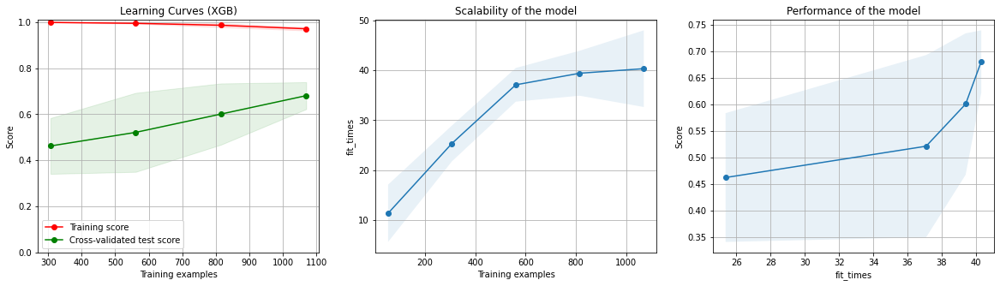

In [253]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))
title = "Learning Curves (XGB)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)
plot_learning_curve(model, title, X_complete, y, 
                    #axes=axes[:, 0], 
                    ylim=(0.0, 1.01),
                    cv=5, n_jobs=4, train_sizes=np.linspace(0.05, 1.0, 5))

plt.show()

Hyperparameter optimization can overfit a dataset and provide an optimistic evaluation of a model that should not be used for model selection.

https://machinelearningmastery.com/nested-cross-validation-for-machine-learning-with-python/

The k-fold cross-validation procedure is an effective approach for estimating the performance of a model. Nevertheless, a limitation of the procedure is that if it is used multiple times with the same algorithm, it can lead to overfitting.

It is common to use k=10 for the outer loop and a smaller value of k for the inner loop, such as k=3 or k=5.

Each time a model with different model hyperparameters is evaluated on a dataset, it provides information about the dataset. Specifically, an often noisy model performance score. This knowledge about the model on the dataset can be exploited in the model configuration procedure to find the best performing configuration for the dataset. The k-fold cross-validation procedure attempts to reduce this effect, yet it cannot be removed completely, and some form of hill-climbing or overfitting of the model hyperparameters to the dataset will be performed. This is the normal case for hyperparameter optimization.The problem is that if this score alone is used to then select a model, or the same dataset is used to evaluate the tuned models, then the selection process will be biased by this inadvertent overfitting. The result is an overly optimistic estimate of model performance that does not generalize to new data.

The procedure involves treating model hyperparameter optimization as part of the model itself and evaluating it within the broader k-fold cross-validation procedure for evaluating models for comparison and selection.

As such, the k-fold cross-validation procedure for model hyperparameter optimization is nested inside the k-fold cross-validation procedure for model selection.

_______________________________________